In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [1]:
print(" Step 1: Installing libraries...")

!pip install numpy<2 opencv-python==4.8.0.76 timm albumentations grad-cam -q

print(" Libraries installed.")

# =====================
# Imports
# =====================
import os
import cv2
import math
import random
import gc
from glob import glob

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from tqdm import tqdm

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from torch.cuda.amp import autocast, GradScaler

import albumentations as A
from albumentations.pytorch import ToTensorV2

from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import (
    cohen_kappa_score,
    accuracy_score,
    classification_report,
    confusion_matrix,
)

import timm
import warnings
warnings.filterwarnings("ignore")

print(" Step 1 complete: libraries imported.")


 Step 1: Installing libraries...
/bin/bash: line 1: 2: No such file or directory
 Libraries installed.


/usr/local/lib/python3.11/dist-packages/pydantic/_internal/_generate_schema.py:2249: UnsupportedFieldAttributeWarning: The 'repr' attribute with value False was provided to the `Field()` function, which has no effect in the context it was used. 'repr' is field-specific metadata, and can only be attached to a model field using `Annotated` metadata or by assignment. This may have happened because an `Annotated` type alias using the `type` statement was used, or if the `Field()` function was attached to a single member of a union type.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/pydantic/_internal/_generate_schema.py:2249: UnsupportedFieldAttributeWarning: The 'frozen' attribute with value True was provided to the `Field()` function, which has no effect in the context it was used. 'frozen' is field-specific metadata, and can only be attached to a model field using `Annotated` metadata or by assignment. This may have happened because an `Annotated` type alias using the `type` 

 Step 1 complete: libraries imported.


In [2]:
print("Step 2: Setting configuration and random seed...")

def seed_everything(seed=42):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)

seed_everything(42)

class CFG:
    IMG_SIZE = 224
    BATCH_SIZE = 8
    LR = 1e-4
    EPOCHS = 30
    SEED = 42
    NUM_CLASSES = 4
    DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
    EARLY_STOPPING_PATIENCE = 5
    N_SPLITS = 3
    DATA_DIR = "/kaggle/input/mri-dataset/MRI_T2_224_Combined"  # Adjust path if needed

print(f" Config ready. Device: {CFG.DEVICE}")


Step 2: Setting configuration and random seed...
 Config ready. Device: cuda


In [3]:
print("✅ Step 3: Loading MRI dataset + creating held-out TEST set...")

from sklearn.model_selection import train_test_split

class_map = {"F0": 0, "F1": 1, "F2": 2, "F3": 3}

image_paths, labels = [], []
for folder_name, class_label in class_map.items():
    folder_path = os.path.join(CFG.DATA_DIR, folder_name)
    imgs = glob(os.path.join(folder_path, "*.png"))
    image_paths.extend(imgs)
    labels.extend([class_label] * len(imgs))

df = pd.DataFrame({"image_path": image_paths, "diagnosis": labels})
df = df.sample(frac=1, random_state=CFG.SEED).reset_index(drop=True)

print(f"✅ Total MRI images: {len(df)}")
print("✅ Class distribution (full):")
print(df["diagnosis"].value_counts())

# -----------------------------
# ✅ Held-out TEST split (20%)
# -----------------------------
train_df, test_df = train_test_split(
    df,
    test_size=0.20,
    random_state=CFG.SEED,
    stratify=df["diagnosis"]
)

train_df = train_df.reset_index(drop=True)
test_df  = test_df.reset_index(drop=True)

print("\n✅ Train size:", len(train_df))
print("✅ Test  size:", len(test_df))

print("\n✅ Class distribution (TRAIN):")
print(train_df["diagnosis"].value_counts())

print("\n✅ Class distribution (TEST):")
print(test_df["diagnosis"].value_counts())


✅ Step 3: Loading MRI dataset + creating held-out TEST set...
✅ Total MRI images: 10854
✅ Class distribution (full):
diagnosis
2    3483
1    3280
0    2185
3    1906
Name: count, dtype: int64

✅ Train size: 8683
✅ Test  size: 2171

✅ Class distribution (TRAIN):
diagnosis
2    2786
1    2624
0    1748
3    1525
Name: count, dtype: int64

✅ Class distribution (TEST):
diagnosis
2    697
1    656
0    437
3    381
Name: count, dtype: int64


In [4]:


print(" Step 4: Defining MRI preprocessing (denoise + CLAHE + sharpen)...")

def clahe_equalized(img_rgb):
    lab = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2LAB)
    l, a, b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    l_clahe = clahe.apply(l)
    lab_clahe = cv2.merge((l_clahe, a, b))
    return cv2.cvtColor(lab_clahe, cv2.COLOR_LAB2RGB)

def sharpen(img):
    kernel = np.array([[-1,-1,-1],
                       [-1, 9,-1],
                       [-1,-1,-1]])
    return cv2.filter2D(img, -1, kernel)

def preprocess_for_model(path):
    img = cv2.imread(path)
    if img is None:
        print(f" Warning: Could not read image {path}, returning None.")
        return None

    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Median denoise (MRI-friendly)
    img_denoised = cv2.medianBlur(img_rgb, 3)

    # CLAHE for contrast
    img_clahe = clahe_equalized(img_denoised)

    # Sharpen
    img_sharp = sharpen(img_clahe)

    return img_sharp

print(" Step 4 complete: Advanced MRI preprocessing ready.")


 Step 4: Defining MRI preprocessing (denoise + CLAHE + sharpen)...
 Step 4 complete: Advanced MRI preprocessing ready.


In [5]:
print("✅ Step 5: Defining augmentations and LiverDataset...")

MEAN = [0.485, 0.456, 0.406]
STD  = [0.229, 0.224, 0.225]

train_tfms = A.Compose([
    A.Resize(CFG.IMG_SIZE, CFG.IMG_SIZE),
    A.Rotate(limit=10, p=0.5),
    A.HorizontalFlip(p=0.3),
    A.VerticalFlip(p=0.1),
    A.ShiftScaleRotate(shift_limit=0.02, scale_limit=0.05, rotate_limit=5, p=0.3),
    A.Normalize(mean=MEAN, std=STD),
    ToTensorV2()
])

valid_tfms = A.Compose([
    A.Resize(CFG.IMG_SIZE, CFG.IMG_SIZE),
    A.Normalize(mean=MEAN, std=STD),
    ToTensorV2()
])

class LiverDataset(Dataset):
    def __init__(self, df, transform=None):
        self.df = df.reset_index(drop=True)
        self.transform = transform

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        path = row.image_path
        label = int(row.diagnosis)

        img = preprocess_for_model(path)
        if img is None:
            # fallback – black image (rare)
            img = np.zeros((CFG.IMG_SIZE, CFG.IMG_SIZE, 3), dtype=np.uint8)

        if self.transform is not None:
            img = self.transform(image=img)["image"]

        return img, torch.tensor(label, dtype=torch.long)

print("✅ Dataset class ready.")


✅ Step 5: Defining augmentations and LiverDataset...
✅ Dataset class ready.


In [6]:
# --- CELL: FIXED DENSENET + LGCN MODEL (5-NEIGHBOURS + SELF-LOOPS + CACHE) ---

import torch
import torch.nn as nn
import torch.nn.functional as F
import timm

def build_grid_adjacency(H, W, device, dtype=torch.float32, self_loops=True):
    """
    5-neighbor grid:
      Up, Down, Left, Right, Top-Left diagonal
    + optional self-loops
    Output: normalized adjacency (N,N) with D^{-1/2} A D^{-1/2}
    """
    N = H * W
    A = torch.zeros((N, N), device=device, dtype=dtype)

    # index helper
    def nid(r, c): 
        return r * W + c

    for r in range(H):
        for c in range(W):
            i = nid(r, c)

            # neighbors
            neigh = [
                (r-1, c),   # up
                (r+1, c),   # down
                (r, c-1),   # left
                (r, c+1),   # right
                (r-1, c-1), # top-left diagonal
            ]
            for rr, cc in neigh:
                if 0 <= rr < H and 0 <= cc < W:
                    j = nid(rr, cc)
                    A[i, j] = 1.0

            if self_loops:
                A[i, i] = 1.0

    deg = A.sum(dim=1)                              # (N,)
    deg_inv_sqrt = torch.pow(deg + 1e-6, -0.5)       # (N,)
    D_inv_sqrt = torch.diag(deg_inv_sqrt)            # (N,N)
    A_norm = D_inv_sqrt @ A @ D_inv_sqrt
    return A_norm

class GraphConv(nn.Module):
    """Graph layer: BN + Dropout + ReLU"""
    def __init__(self, in_channels, out_channels, dropout=0.2):
        super().__init__()
        self.linear = nn.Linear(in_channels, out_channels)
        self.bn = nn.BatchNorm1d(out_channels)
        self.dropout = nn.Dropout(dropout)

    def forward(self, x, adj):
        # x: (B, N, C)
        Ax = torch.matmul(adj, x)          # (B, N, C)
        out = self.linear(Ax)              # (B, N, outC)

        # BN: (B, C, N)
        out = out.permute(0, 2, 1)
        out = self.bn(out)
        out = out.permute(0, 2, 1)

        out = self.dropout(out)
        return F.relu(out)

class DenseNetLGCN(nn.Module):
    def __init__(self, num_classes=4):
        super().__init__()
        self.cnn = timm.create_model("densenet121", pretrained=True, num_classes=0, global_pool="")
        in_ch = self.cnn.num_features  # usually 1024

        self.gcn1 = GraphConv(in_ch, 512, dropout=0.25)
        self.gcn2 = GraphConv(512, 256, dropout=0.25)
        self.fc   = nn.Linear(256, num_classes)

        # adjacency cache: {(H,W,device,dtype): A_norm}
        self._adj_cache = {}

    def _get_features(self, x):
        return self.cnn.forward_features(x)   # (B,C,H,W)

    def _get_adj(self, H, W, device, dtype):
        key = (H, W, str(device), str(dtype))
        if key not in self._adj_cache:
            A = build_grid_adjacency(H, W, device=device, dtype=dtype, self_loops=True)
            self._adj_cache[key] = A
        return self._adj_cache[key]

    # ✅ XAI hook: node importance map (B,H,W)
    def get_graph_activations(self, x):
        feat = self._get_features(x)
        B, C, H, W = feat.shape
        N = H * W

        x_nodes = feat.view(B, C, N).permute(0, 2, 1).contiguous()  # (B,N,C)
        adj = self._get_adj(H, W, feat.device, x_nodes.dtype)       # (N,N)

        h = self.gcn1(x_nodes, adj)
        h = self.gcn2(h, adj)

        node_map = h.norm(dim=2).view(B, H, W)                      # (B,H,W)
        return node_map

    def forward(self, x):
        feat = self._get_features(x)
        B, C, H, W = feat.shape
        N = H * W

        x_nodes = feat.view(B, C, N).permute(0, 2, 1).contiguous()  # (B,N,C)
        adj = self._get_adj(H, W, feat.device, x_nodes.dtype)

        h = self.gcn1(x_nodes, adj)
        h = self.gcn2(h, adj)

        graph_feat = h.mean(dim=1)  # (B,256)
        return self.fc(graph_feat)

print("✅ FIXED DenseNet + LGCN Model Defined (5-Neighbour + Self-Loops + XAI Hook).")


✅ FIXED DenseNet + LGCN Model Defined (5-Neighbour + Self-Loops + XAI Hook).


In [8]:
print("✅ Step 7: Defining loss + K-fold splits on TRAIN only...")

class FocalLoss(nn.Module):
    def __init__(self, alpha=1.0, gamma=2.0):
        super().__init__()
        self.alpha = alpha
        self.gamma = gamma
        self.ce = nn.CrossEntropyLoss(reduction="none")

    def forward(self, inputs, targets):
        ce_loss = self.ce(inputs, targets)
        pt = torch.exp(-ce_loss)
        return (self.alpha * (1 - pt)**self.gamma * ce_loss).mean()

skf = StratifiedKFold(n_splits=CFG.N_SPLITS, shuffle=True, random_state=CFG.SEED)

# ✅ IMPORTANT: split train_df (NOT full df)
splits = list(skf.split(train_df, train_df["diagnosis"]))

print(f"✅ Step 7 complete: {CFG.N_SPLITS} folds prepared (TRAIN only).")


✅ Step 7: Defining loss + K-fold splits on TRAIN only...
✅ Step 7 complete: 3 folds prepared (TRAIN only).


In [9]:
print("🚀 Step 8: Training DenseNet+LGCN with 3-fold CV (TRAIN only)...")

def train_one_fold(fold_id, train_idx, valid_idx):
    print(f"\n===================== 🚀 FOLD {fold_id+1}/{CFG.N_SPLITS} =====================")

    # ✅ Use TRAIN_DF (not df) to avoid leakage into test_df
    tr_df = train_df.iloc[train_idx].reset_index(drop=True)
    va_df = train_df.iloc[valid_idx].reset_index(drop=True)

    # Weighted sampler (handle imbalance)
    class_counts = tr_df["diagnosis"].value_counts().to_dict()
    weights_per_class = {cls: 1.0 / cnt for cls, cnt in class_counts.items()}
    weights = [weights_per_class[c] for c in tr_df["diagnosis"]]
    sampler = WeightedRandomSampler(weights, num_samples=len(weights), replacement=True)

    train_loader = DataLoader(
        LiverDataset(tr_df, transform=train_tfms),
        batch_size=CFG.BATCH_SIZE,
        sampler=sampler,
        num_workers=2,
        pin_memory=True,
    )
    valid_loader = DataLoader(
        LiverDataset(va_df, transform=valid_tfms),
        batch_size=CFG.BATCH_SIZE,
        shuffle=False,
        num_workers=2,
        pin_memory=True,
    )

    gc.collect()
    if CFG.DEVICE == "cuda":
        torch.cuda.empty_cache()

    model = DenseNetLGCN(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)
    criterion = FocalLoss()
    optimizer = optim.AdamW(model.parameters(), lr=CFG.LR, weight_decay=1e-4)
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode="max", factor=0.5, patience=3)
    scaler = GradScaler()

    best_qwk = -1.0
    no_improve = 0

    for epoch in range(CFG.EPOCHS):
        # ---------- TRAIN ----------
        model.train()
        train_loss_sum = 0.0
        train_correct = 0
        train_total = 0

        pbar = tqdm(train_loader, desc=f"Fold {fold_id+1} Ep {epoch+1}/{CFG.EPOCHS} [Train]", leave=False)
        for images, labels in pbar:
            images = images.to(CFG.DEVICE)
            labels = labels.to(CFG.DEVICE)

            optimizer.zero_grad()
            with autocast():
                outputs = model(images)
                loss = criterion(outputs, labels)

            scaler.scale(loss).backward()
            scaler.step(optimizer)
            scaler.update()

            preds = outputs.argmax(dim=1)
            train_loss_sum += loss.item() * images.size(0)
            train_correct += (preds == labels).sum().item()
            train_total += labels.size(0)

            pbar.set_postfix(loss=train_loss_sum/train_total, acc=train_correct/train_total)

        train_loss = train_loss_sum / train_total
        train_acc  = train_correct / train_total

        # ---------- VALID ----------
        model.eval()
        val_loss_sum = 0.0
        val_total = 0
        all_preds, all_labels = [], []

        with torch.no_grad():
            pbarv = tqdm(valid_loader, desc=f"Fold {fold_id+1} Ep {epoch+1}/{CFG.EPOCHS} [Valid]", leave=False)
            for images, labels in pbarv:
                images = images.to(CFG.DEVICE)
                labels = labels.to(CFG.DEVICE)

                with autocast():
                    outputs = model(images)
                    loss = criterion(outputs, labels)

                preds = outputs.argmax(dim=1)
                val_loss_sum += loss.item() * images.size(0)
                val_total += labels.size(0)

                all_preds.extend(preds.cpu().numpy())
                all_labels.extend(labels.cpu().numpy())

                pbarv.set_postfix(loss=val_loss_sum/val_total)

        val_loss = val_loss_sum / val_total
        val_acc  = accuracy_score(all_labels, all_preds)
        val_qwk  = cohen_kappa_score(all_labels, all_preds, weights="quadratic")

        scheduler.step(val_qwk)

        print(f"\nEpoch {epoch+1}/{CFG.EPOCHS} (Fold {fold_id+1})")
        print(f"  Train Loss: {train_loss:.4f} | Train Acc: {train_acc:.4f}")
        print(f"  Val   Loss: {val_loss:.4f} | Val   Acc: {val_acc:.4f} | ⭐ QWK: {val_qwk:.4f}")

        # ✅ Save best weights with SHORT consistent name
        save_path = f"lgcn_fold{fold_id+1}.pth"
        if val_qwk > best_qwk:
            best_qwk = val_qwk
            no_improve = 0
            torch.save(model.state_dict(), save_path)
            print(f"✅ New best saved: {save_path}  (QWK={best_qwk:.4f})")
        else:
            no_improve += 1
            print(f"⚠️ No improvement: {no_improve}/{CFG.EARLY_STOPPING_PATIENCE}")

        if no_improve >= CFG.EARLY_STOPPING_PATIENCE:
            print(f"🛑 Early stopping at epoch {epoch+1} (Fold {fold_id+1})")
            break

    print(f"✅ Fold {fold_id+1} complete. Best QWK: {best_qwk:.4f}")
    return best_qwk


# ---- Run all folds ----
fold_qwks = []
for fold_id, (tr_idx, va_idx) in enumerate(splits):
    best_qwk = train_one_fold(fold_id, tr_idx, va_idx)
    fold_qwks.append(best_qwk)

print("\n========================================")
print("✅ DenseNet + LGCN (MRI) CV Summary")
for i, q in enumerate(fold_qwks, start=1):
    print(f"Fold {i}: Best QWK = {q:.4f}")
print(f"Average Best QWK: {np.mean(fold_qwks):.4f}")
print("========================================")


🚀 Step 8: Training DenseNet+LGCN with 3-fold CV (TRAIN only)...

===================== 🚀 FOLD 1/3 =====================


model.safetensors:   0%|          | 0.00/32.3M [00:00<?, ?B/s]


Epoch 1/30 (Fold 1)
  Train Loss: 0.4970 | Train Acc: 0.5655
  Val   Loss: 0.3865 | Val   Acc: 0.6408 | ⭐ QWK: 0.7430
✅ New best saved: lgcn_fold1.pth  (QWK=0.7430)



Epoch 2/30 (Fold 1)
  Train Loss: 0.3155 | Train Acc: 0.7179
  Val   Loss: 0.2163 | Val   Acc: 0.7793 | ⭐ QWK: 0.8470
✅ New best saved: lgcn_fold1.pth  (QWK=0.8470)



Epoch 3/30 (Fold 1)
  Train Loss: 0.2510 | Train Acc: 0.7773
  Val   Loss: 0.1951 | Val   Acc: 0.8010 | ⭐ QWK: 0.8526
✅ New best saved: lgcn_fold1.pth  (QWK=0.8526)



Epoch 4/30 (Fold 1)
  Train Loss: 0.1969 | Train Acc: 0.8157
  Val   Loss: 0.1401 | Val   Acc: 0.8570 | ⭐ QWK: 0.8878
✅ New best saved: lgcn_fold1.pth  (QWK=0.8878)



Epoch 5/30 (Fold 1)
  Train Loss: 0.1628 | Train Acc: 0.8514
  Val   Loss: 0.1417 | Val   Acc: 0.8611 | ⭐ QWK: 0.8991
✅ New best saved: lgcn_fold1.pth  (QWK=0.8991)



Epoch 6/30 (Fold 1)
  Train Loss: 0.1342 | Train Acc: 0.8713
  Val   Loss: 0.0992 | Val   Acc: 0.8950 | ⭐ QWK: 0.9137
✅ New best saved: lgcn_fold1.pth  (QWK=0.9137)



Epoch 7/30 (Fold 1)
  Train Loss: 0.1383 | Train Acc: 0.8706
  Val   Loss: 0.0914 | Val   Acc: 0.9098 | ⭐ QWK: 0.9383
✅ New best saved: lgcn_fold1.pth  (QWK=0.9383)



Epoch 8/30 (Fold 1)
  Train Loss: 0.1081 | Train Acc: 0.9000
  Val   Loss: 0.1098 | Val   Acc: 0.8933 | ⭐ QWK: 0.9139
⚠️ No improvement: 1/5



Epoch 9/30 (Fold 1)
  Train Loss: 0.0999 | Train Acc: 0.9045
  Val   Loss: 0.1018 | Val   Acc: 0.9081 | ⭐ QWK: 0.8989
⚠️ No improvement: 2/5



Epoch 10/30 (Fold 1)
  Train Loss: 0.0963 | Train Acc: 0.9083
  Val   Loss: 0.0825 | Val   Acc: 0.9174 | ⭐ QWK: 0.9324
⚠️ No improvement: 3/5



Epoch 11/30 (Fold 1)
  Train Loss: 0.0810 | Train Acc: 0.9228
  Val   Loss: 0.0646 | Val   Acc: 0.9358 | ⭐ QWK: 0.9534
✅ New best saved: lgcn_fold1.pth  (QWK=0.9534)



Epoch 12/30 (Fold 1)
  Train Loss: 0.0775 | Train Acc: 0.9283
  Val   Loss: 0.0631 | Val   Acc: 0.9378 | ⭐ QWK: 0.9498
⚠️ No improvement: 1/5



Epoch 13/30 (Fold 1)
  Train Loss: 0.0731 | Train Acc: 0.9305
  Val   Loss: 0.0600 | Val   Acc: 0.9434 | ⭐ QWK: 0.9544
✅ New best saved: lgcn_fold1.pth  (QWK=0.9544)



Epoch 14/30 (Fold 1)
  Train Loss: 0.0671 | Train Acc: 0.9314
  Val   Loss: 0.0468 | Val   Acc: 0.9430 | ⭐ QWK: 0.9561
✅ New best saved: lgcn_fold1.pth  (QWK=0.9561)



Epoch 15/30 (Fold 1)
  Train Loss: 0.0631 | Train Acc: 0.9400
  Val   Loss: 0.0677 | Val   Acc: 0.9299 | ⭐ QWK: 0.9449
⚠️ No improvement: 1/5



Epoch 16/30 (Fold 1)
  Train Loss: 0.0695 | Train Acc: 0.9347
  Val   Loss: 0.0525 | Val   Acc: 0.9513 | ⭐ QWK: 0.9655
✅ New best saved: lgcn_fold1.pth  (QWK=0.9655)



Epoch 17/30 (Fold 1)
  Train Loss: 0.0508 | Train Acc: 0.9506
  Val   Loss: 0.0398 | Val   Acc: 0.9565 | ⭐ QWK: 0.9651
⚠️ No improvement: 1/5



Epoch 18/30 (Fold 1)
  Train Loss: 0.0501 | Train Acc: 0.9502
  Val   Loss: 0.0621 | Val   Acc: 0.9465 | ⭐ QWK: 0.9542
⚠️ No improvement: 2/5



Epoch 19/30 (Fold 1)
  Train Loss: 0.0588 | Train Acc: 0.9496
  Val   Loss: 0.0495 | Val   Acc: 0.9558 | ⭐ QWK: 0.9621
⚠️ No improvement: 3/5



Epoch 20/30 (Fold 1)
  Train Loss: 0.0497 | Train Acc: 0.9516
  Val   Loss: 0.0627 | Val   Acc: 0.9444 | ⭐ QWK: 0.9507
⚠️ No improvement: 4/5



Epoch 21/30 (Fold 1)
  Train Loss: 0.0316 | Train Acc: 0.9705
  Val   Loss: 0.0279 | Val   Acc: 0.9737 | ⭐ QWK: 0.9803
✅ New best saved: lgcn_fold1.pth  (QWK=0.9803)



Epoch 22/30 (Fold 1)
  Train Loss: 0.0252 | Train Acc: 0.9800
  Val   Loss: 0.0282 | Val   Acc: 0.9737 | ⭐ QWK: 0.9782
⚠️ No improvement: 1/5



Epoch 23/30 (Fold 1)
  Train Loss: 0.0197 | Train Acc: 0.9800
  Val   Loss: 0.0292 | Val   Acc: 0.9758 | ⭐ QWK: 0.9772
⚠️ No improvement: 2/5



Epoch 24/30 (Fold 1)
  Train Loss: 0.0202 | Train Acc: 0.9808
  Val   Loss: 0.0308 | Val   Acc: 0.9703 | ⭐ QWK: 0.9742
⚠️ No improvement: 3/5



Epoch 25/30 (Fold 1)
  Train Loss: 0.0224 | Train Acc: 0.9775
  Val   Loss: 0.0246 | Val   Acc: 0.9755 | ⭐ QWK: 0.9795
⚠️ No improvement: 4/5



Epoch 26/30 (Fold 1)
  Train Loss: 0.0147 | Train Acc: 0.9864
  Val   Loss: 0.0152 | Val   Acc: 0.9851 | ⭐ QWK: 0.9866
✅ New best saved: lgcn_fold1.pth  (QWK=0.9866)



Epoch 27/30 (Fold 1)
  Train Loss: 0.0147 | Train Acc: 0.9858
  Val   Loss: 0.0201 | Val   Acc: 0.9841 | ⭐ QWK: 0.9866
⚠️ No improvement: 1/5



Epoch 28/30 (Fold 1)
  Train Loss: 0.0097 | Train Acc: 0.9912
  Val   Loss: 0.0161 | Val   Acc: 0.9858 | ⭐ QWK: 0.9860
⚠️ No improvement: 2/5



Epoch 29/30 (Fold 1)
  Train Loss: 0.0087 | Train Acc: 0.9919
  Val   Loss: 0.0163 | Val   Acc: 0.9848 | ⭐ QWK: 0.9869
✅ New best saved: lgcn_fold1.pth  (QWK=0.9869)



Epoch 30/30 (Fold 1)
  Train Loss: 0.0188 | Train Acc: 0.9883
  Val   Loss: 0.0257 | Val   Acc: 0.9782 | ⭐ QWK: 0.9822
⚠️ No improvement: 1/5
✅ Fold 1 complete. Best QWK: 0.9869

===================== 🚀 FOLD 2/3 =====================



Epoch 1/30 (Fold 2)
  Train Loss: 0.4833 | Train Acc: 0.5733
  Val   Loss: 0.3546 | Val   Acc: 0.6579 | ⭐ QWK: 0.7548
✅ New best saved: lgcn_fold2.pth  (QWK=0.7548)



Epoch 2/30 (Fold 2)
  Train Loss: 0.3259 | Train Acc: 0.7072
  Val   Loss: 0.2485 | Val   Acc: 0.7571 | ⭐ QWK: 0.8049
✅ New best saved: lgcn_fold2.pth  (QWK=0.8049)



Epoch 3/30 (Fold 2)
  Train Loss: 0.2441 | Train Acc: 0.7723
  Val   Loss: 0.2110 | Val   Acc: 0.7937 | ⭐ QWK: 0.8399
✅ New best saved: lgcn_fold2.pth  (QWK=0.8399)



Epoch 4/30 (Fold 2)
  Train Loss: 0.1959 | Train Acc: 0.8190
  Val   Loss: 0.1661 | Val   Acc: 0.8400 | ⭐ QWK: 0.8784
✅ New best saved: lgcn_fold2.pth  (QWK=0.8784)



Epoch 5/30 (Fold 2)
  Train Loss: 0.1625 | Train Acc: 0.8471
  Val   Loss: 0.1314 | Val   Acc: 0.8663 | ⭐ QWK: 0.8922
✅ New best saved: lgcn_fold2.pth  (QWK=0.8922)



Epoch 6/30 (Fold 2)
  Train Loss: 0.1335 | Train Acc: 0.8701
  Val   Loss: 0.1332 | Val   Acc: 0.8763 | ⭐ QWK: 0.8962
✅ New best saved: lgcn_fold2.pth  (QWK=0.8962)



Epoch 7/30 (Fold 2)
  Train Loss: 0.1228 | Train Acc: 0.8851
  Val   Loss: 0.1086 | Val   Acc: 0.8998 | ⭐ QWK: 0.9208
✅ New best saved: lgcn_fold2.pth  (QWK=0.9208)



Epoch 8/30 (Fold 2)
  Train Loss: 0.1067 | Train Acc: 0.8970
  Val   Loss: 0.1073 | Val   Acc: 0.9091 | ⭐ QWK: 0.9230
✅ New best saved: lgcn_fold2.pth  (QWK=0.9230)



Epoch 9/30 (Fold 2)
  Train Loss: 0.0977 | Train Acc: 0.9078
  Val   Loss: 0.1041 | Val   Acc: 0.9057 | ⭐ QWK: 0.9228
⚠️ No improvement: 1/5



Epoch 10/30 (Fold 2)
  Train Loss: 0.1010 | Train Acc: 0.9086
  Val   Loss: 0.0945 | Val   Acc: 0.9185 | ⭐ QWK: 0.9323
✅ New best saved: lgcn_fold2.pth  (QWK=0.9323)



Epoch 11/30 (Fold 2)
  Train Loss: 0.0903 | Train Acc: 0.9145
  Val   Loss: 0.0777 | Val   Acc: 0.9406 | ⭐ QWK: 0.9558
✅ New best saved: lgcn_fold2.pth  (QWK=0.9558)



Epoch 12/30 (Fold 2)
  Train Loss: 0.0707 | Train Acc: 0.9326
  Val   Loss: 0.0749 | Val   Acc: 0.9323 | ⭐ QWK: 0.9400
⚠️ No improvement: 1/5



Epoch 13/30 (Fold 2)
  Train Loss: 0.0688 | Train Acc: 0.9318
  Val   Loss: 0.0801 | Val   Acc: 0.9350 | ⭐ QWK: 0.9391
⚠️ No improvement: 2/5



Epoch 14/30 (Fold 2)
  Train Loss: 0.0590 | Train Acc: 0.9418
  Val   Loss: 0.0927 | Val   Acc: 0.9209 | ⭐ QWK: 0.9289
⚠️ No improvement: 3/5



Epoch 15/30 (Fold 2)
  Train Loss: 0.0597 | Train Acc: 0.9426
  Val   Loss: 0.0744 | Val   Acc: 0.9281 | ⭐ QWK: 0.9355
⚠️ No improvement: 4/5



Epoch 16/30 (Fold 2)
  Train Loss: 0.0417 | Train Acc: 0.9575
  Val   Loss: 0.0434 | Val   Acc: 0.9620 | ⭐ QWK: 0.9663
✅ New best saved: lgcn_fold2.pth  (QWK=0.9663)



Epoch 17/30 (Fold 2)
  Train Loss: 0.0323 | Train Acc: 0.9706
  Val   Loss: 0.0531 | Val   Acc: 0.9551 | ⭐ QWK: 0.9604
⚠️ No improvement: 1/5



Epoch 18/30 (Fold 2)
  Train Loss: 0.0274 | Train Acc: 0.9739
  Val   Loss: 0.0441 | Val   Acc: 0.9599 | ⭐ QWK: 0.9683
✅ New best saved: lgcn_fold2.pth  (QWK=0.9683)



Epoch 19/30 (Fold 2)
  Train Loss: 0.0295 | Train Acc: 0.9708
  Val   Loss: 0.0486 | Val   Acc: 0.9603 | ⭐ QWK: 0.9562
⚠️ No improvement: 1/5



Epoch 20/30 (Fold 2)
  Train Loss: 0.0279 | Train Acc: 0.9736
  Val   Loss: 0.0377 | Val   Acc: 0.9703 | ⭐ QWK: 0.9731
✅ New best saved: lgcn_fold2.pth  (QWK=0.9731)



Epoch 21/30 (Fold 2)
  Train Loss: 0.0194 | Train Acc: 0.9796
  Val   Loss: 0.0386 | Val   Acc: 0.9758 | ⭐ QWK: 0.9752
✅ New best saved: lgcn_fold2.pth  (QWK=0.9752)



Epoch 22/30 (Fold 2)
  Train Loss: 0.0231 | Train Acc: 0.9767
  Val   Loss: 0.0470 | Val   Acc: 0.9689 | ⭐ QWK: 0.9657
⚠️ No improvement: 1/5



Epoch 23/30 (Fold 2)
  Train Loss: 0.0224 | Train Acc: 0.9777
  Val   Loss: 0.0366 | Val   Acc: 0.9692 | ⭐ QWK: 0.9709
⚠️ No improvement: 2/5



Epoch 24/30 (Fold 2)
  Train Loss: 0.0179 | Train Acc: 0.9820
  Val   Loss: 0.0344 | Val   Acc: 0.9710 | ⭐ QWK: 0.9725
⚠️ No improvement: 3/5



Epoch 25/30 (Fold 2)
  Train Loss: 0.0212 | Train Acc: 0.9798
  Val   Loss: 0.0384 | Val   Acc: 0.9692 | ⭐ QWK: 0.9744
⚠️ No improvement: 4/5



Epoch 26/30 (Fold 2)
  Train Loss: 0.0152 | Train Acc: 0.9848
  Val   Loss: 0.0332 | Val   Acc: 0.9720 | ⭐ QWK: 0.9678
⚠️ No improvement: 5/5
🛑 Early stopping at epoch 26 (Fold 2)
✅ Fold 2 complete. Best QWK: 0.9752

===================== 🚀 FOLD 3/3 =====================



Epoch 1/30 (Fold 3)
  Train Loss: 0.4817 | Train Acc: 0.5778
  Val   Loss: 0.3260 | Val   Acc: 0.6710 | ⭐ QWK: 0.7524
✅ New best saved: lgcn_fold3.pth  (QWK=0.7524)



Epoch 2/30 (Fold 3)
  Train Loss: 0.3231 | Train Acc: 0.7025
  Val   Loss: 0.2662 | Val   Acc: 0.7450 | ⭐ QWK: 0.8090
✅ New best saved: lgcn_fold3.pth  (QWK=0.8090)



Epoch 3/30 (Fold 3)
  Train Loss: 0.2364 | Train Acc: 0.7808
  Val   Loss: 0.1949 | Val   Acc: 0.8106 | ⭐ QWK: 0.8566
✅ New best saved: lgcn_fold3.pth  (QWK=0.8566)



Epoch 4/30 (Fold 3)
  Train Loss: 0.2008 | Train Acc: 0.8178
  Val   Loss: 0.1563 | Val   Acc: 0.8469 | ⭐ QWK: 0.8788
✅ New best saved: lgcn_fold3.pth  (QWK=0.8788)



Epoch 5/30 (Fold 3)
  Train Loss: 0.1640 | Train Acc: 0.8452
  Val   Loss: 0.1299 | Val   Acc: 0.8704 | ⭐ QWK: 0.8939
✅ New best saved: lgcn_fold3.pth  (QWK=0.8939)



Epoch 6/30 (Fold 3)
  Train Loss: 0.1351 | Train Acc: 0.8801
  Val   Loss: 0.1181 | Val   Acc: 0.8839 | ⭐ QWK: 0.9077
✅ New best saved: lgcn_fold3.pth  (QWK=0.9077)



Epoch 7/30 (Fold 3)
  Train Loss: 0.1138 | Train Acc: 0.8932
  Val   Loss: 0.1087 | Val   Acc: 0.8915 | ⭐ QWK: 0.9104
✅ New best saved: lgcn_fold3.pth  (QWK=0.9104)



Epoch 8/30 (Fold 3)
  Train Loss: 0.1101 | Train Acc: 0.8960
  Val   Loss: 0.0760 | Val   Acc: 0.9240 | ⭐ QWK: 0.9411
✅ New best saved: lgcn_fold3.pth  (QWK=0.9411)



Epoch 9/30 (Fold 3)
  Train Loss: 0.1047 | Train Acc: 0.9022
  Val   Loss: 0.0866 | Val   Acc: 0.9160 | ⭐ QWK: 0.9322
⚠️ No improvement: 1/5



Epoch 10/30 (Fold 3)
  Train Loss: 0.0907 | Train Acc: 0.9162
  Val   Loss: 0.0823 | Val   Acc: 0.9157 | ⭐ QWK: 0.9332
⚠️ No improvement: 2/5



Epoch 11/30 (Fold 3)
  Train Loss: 0.0789 | Train Acc: 0.9268
  Val   Loss: 0.0734 | Val   Acc: 0.9271 | ⭐ QWK: 0.9355
⚠️ No improvement: 3/5



Epoch 12/30 (Fold 3)
  Train Loss: 0.0815 | Train Acc: 0.9223
  Val   Loss: 0.0709 | Val   Acc: 0.9309 | ⭐ QWK: 0.9424
✅ New best saved: lgcn_fold3.pth  (QWK=0.9424)



Epoch 13/30 (Fold 3)
  Train Loss: 0.0678 | Train Acc: 0.9392
  Val   Loss: 0.0879 | Val   Acc: 0.9302 | ⭐ QWK: 0.9335
⚠️ No improvement: 1/5



Epoch 14/30 (Fold 3)
  Train Loss: 0.0749 | Train Acc: 0.9287
  Val   Loss: 0.0609 | Val   Acc: 0.9409 | ⭐ QWK: 0.9529
✅ New best saved: lgcn_fold3.pth  (QWK=0.9529)



Epoch 15/30 (Fold 3)
  Train Loss: 0.0619 | Train Acc: 0.9401
  Val   Loss: 0.0482 | Val   Acc: 0.9554 | ⭐ QWK: 0.9630
✅ New best saved: lgcn_fold3.pth  (QWK=0.9630)



Epoch 16/30 (Fold 3)
  Train Loss: 0.0555 | Train Acc: 0.9487
  Val   Loss: 0.0502 | Val   Acc: 0.9485 | ⭐ QWK: 0.9605
⚠️ No improvement: 1/5



Epoch 17/30 (Fold 3)
  Train Loss: 0.0634 | Train Acc: 0.9413
  Val   Loss: 0.0534 | Val   Acc: 0.9540 | ⭐ QWK: 0.9632
✅ New best saved: lgcn_fold3.pth  (QWK=0.9632)



Epoch 18/30 (Fold 3)
  Train Loss: 0.0597 | Train Acc: 0.9449
  Val   Loss: 0.0535 | Val   Acc: 0.9502 | ⭐ QWK: 0.9575
⚠️ No improvement: 1/5



Epoch 19/30 (Fold 3)
  Train Loss: 0.0460 | Train Acc: 0.9599
  Val   Loss: 0.0484 | Val   Acc: 0.9554 | ⭐ QWK: 0.9608
⚠️ No improvement: 2/5



Epoch 20/30 (Fold 3)
  Train Loss: 0.0626 | Train Acc: 0.9440
  Val   Loss: 0.0605 | Val   Acc: 0.9447 | ⭐ QWK: 0.9417
⚠️ No improvement: 3/5



Epoch 21/30 (Fold 3)
  Train Loss: 0.0399 | Train Acc: 0.9617
  Val   Loss: 0.0497 | Val   Acc: 0.9572 | ⭐ QWK: 0.9643
✅ New best saved: lgcn_fold3.pth  (QWK=0.9643)



Epoch 22/30 (Fold 3)
  Train Loss: 0.0509 | Train Acc: 0.9522
  Val   Loss: 0.0346 | Val   Acc: 0.9644 | ⭐ QWK: 0.9747
✅ New best saved: lgcn_fold3.pth  (QWK=0.9747)



Epoch 23/30 (Fold 3)
  Train Loss: 0.0418 | Train Acc: 0.9558
  Val   Loss: 0.0521 | Val   Acc: 0.9544 | ⭐ QWK: 0.9497
⚠️ No improvement: 1/5



Epoch 24/30 (Fold 3)
  Train Loss: 0.0339 | Train Acc: 0.9641
  Val   Loss: 0.0543 | Val   Acc: 0.9499 | ⭐ QWK: 0.9586
⚠️ No improvement: 2/5



Epoch 25/30 (Fold 3)
  Train Loss: 0.0444 | Train Acc: 0.9570
  Val   Loss: 0.0720 | Val   Acc: 0.9375 | ⭐ QWK: 0.9444
⚠️ No improvement: 3/5



Epoch 26/30 (Fold 3)
  Train Loss: 0.0275 | Train Acc: 0.9706
  Val   Loss: 0.0462 | Val   Acc: 0.9572 | ⭐ QWK: 0.9626
⚠️ No improvement: 4/5



Epoch 27/30 (Fold 3)
  Train Loss: 0.0214 | Train Acc: 0.9772
  Val   Loss: 0.0285 | Val   Acc: 0.9734 | ⭐ QWK: 0.9726
⚠️ No improvement: 5/5
🛑 Early stopping at epoch 27 (Fold 3)
✅ Fold 3 complete. Best QWK: 0.9747

✅ DenseNet + LGCN (MRI) CV Summary
Fold 1: Best QWK = 0.9869
Fold 2: Best QWK = 0.9752
Fold 3: Best QWK = 0.9747
Average Best QWK: 0.9789



📌 LGCN + DenseNet (MRI): PER-FOLD (fold-model-on-test) + OVERALL (600 DPI)

🔹 Fold-model 1 on TEST set...
✅ Fold 1 TEST Accuracy: 0.9788
✅ Fold 1 TEST QWK:      0.9802


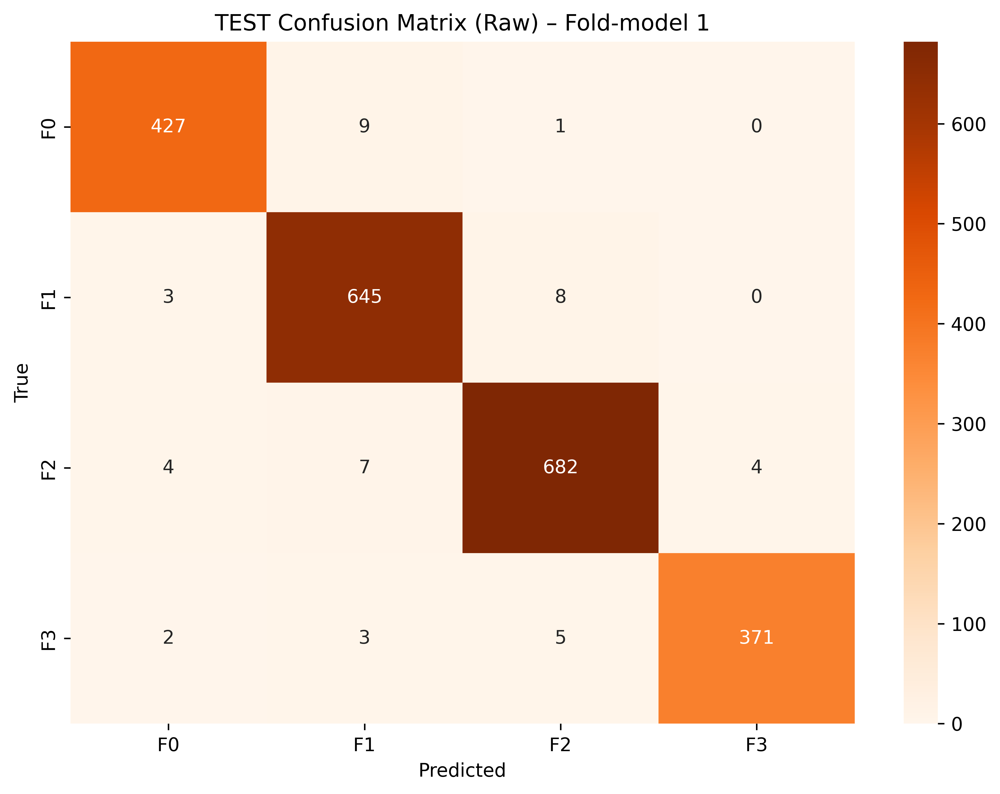

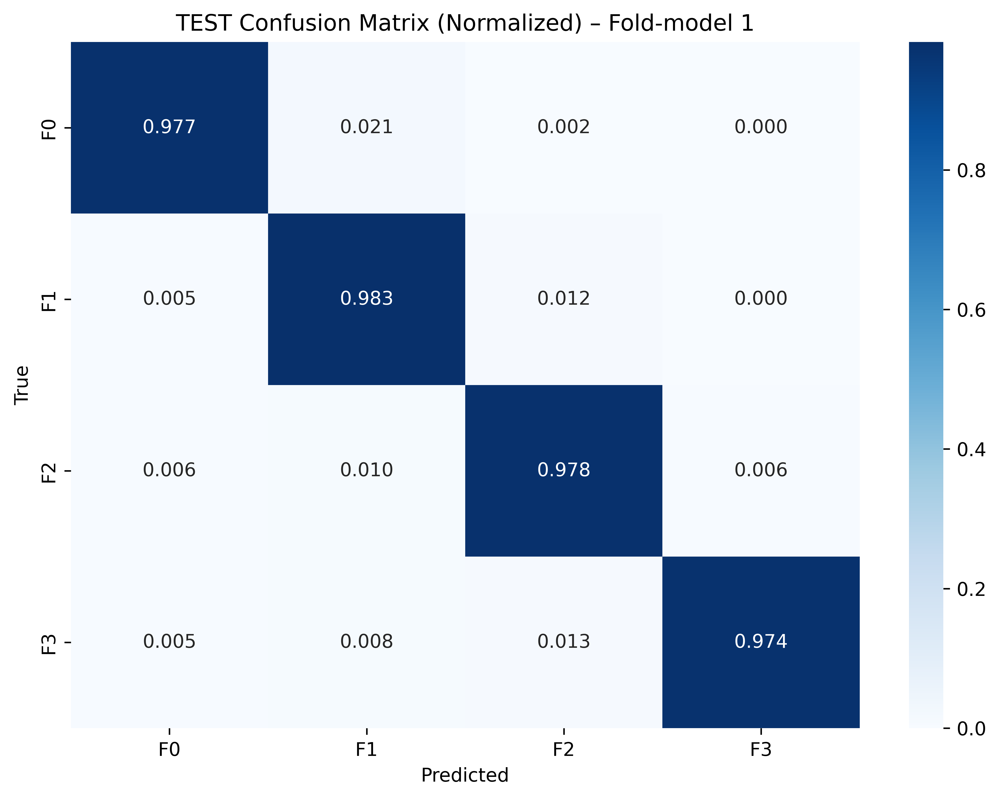


📄 Classification Report (Fold-model 1 on TEST):
              precision    recall  f1-score   support

          F0     0.9794    0.9771    0.9782       437
          F1     0.9714    0.9832    0.9773       656
          F2     0.9799    0.9785    0.9792       697
          F3     0.9893    0.9738    0.9815       381

    accuracy                         0.9788      2171
   macro avg     0.9800    0.9781    0.9790      2171
weighted avg     0.9789    0.9788    0.9788      2171


🔹 Fold-model 2 on TEST set...
✅ Fold 2 TEST Accuracy: 0.9751
✅ Fold 2 TEST QWK:      0.9723


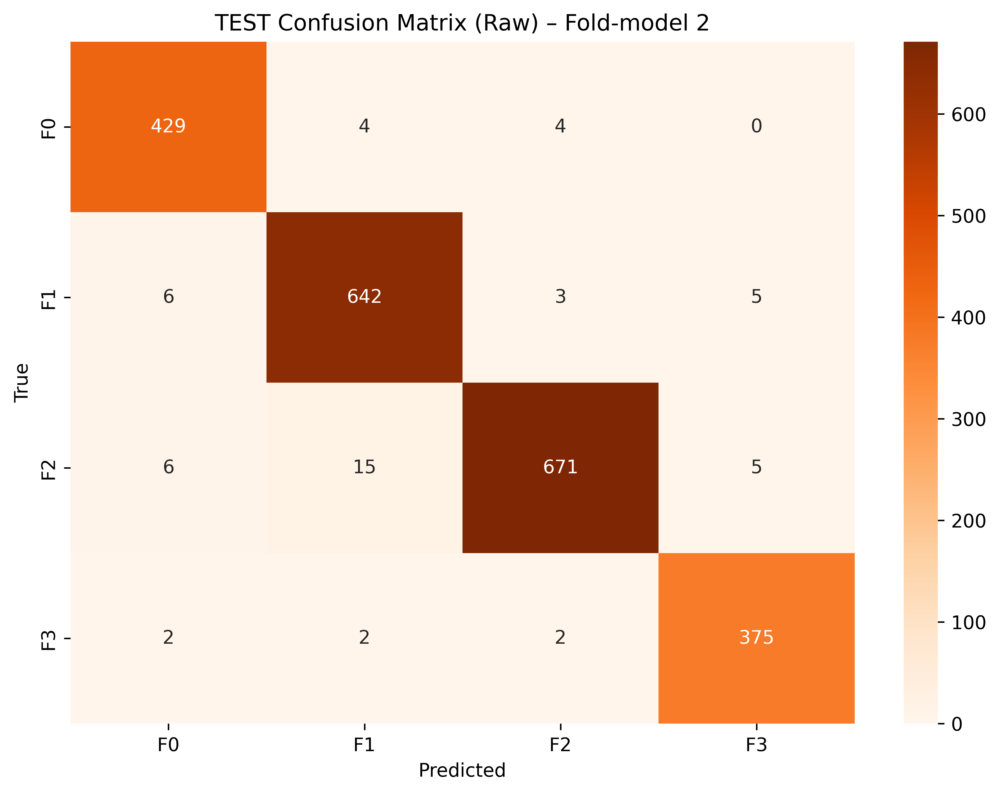

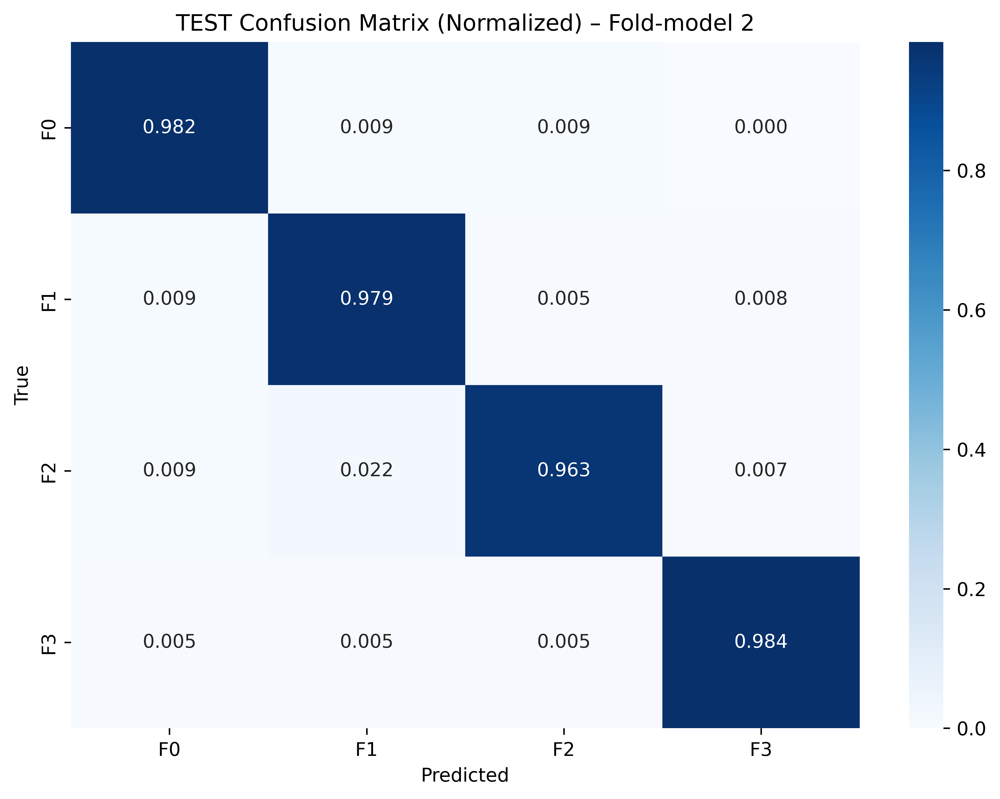


📄 Classification Report (Fold-model 2 on TEST):
              precision    recall  f1-score   support

          F0     0.9684    0.9817    0.9750       437
          F1     0.9683    0.9787    0.9735       656
          F2     0.9868    0.9627    0.9746       697
          F3     0.9740    0.9843    0.9791       381

    accuracy                         0.9751      2171
   macro avg     0.9744    0.9768    0.9755      2171
weighted avg     0.9753    0.9751    0.9751      2171


🔹 Fold-model 3 on TEST set...
✅ Fold 3 TEST Accuracy: 0.9544
✅ Fold 3 TEST QWK:      0.9678


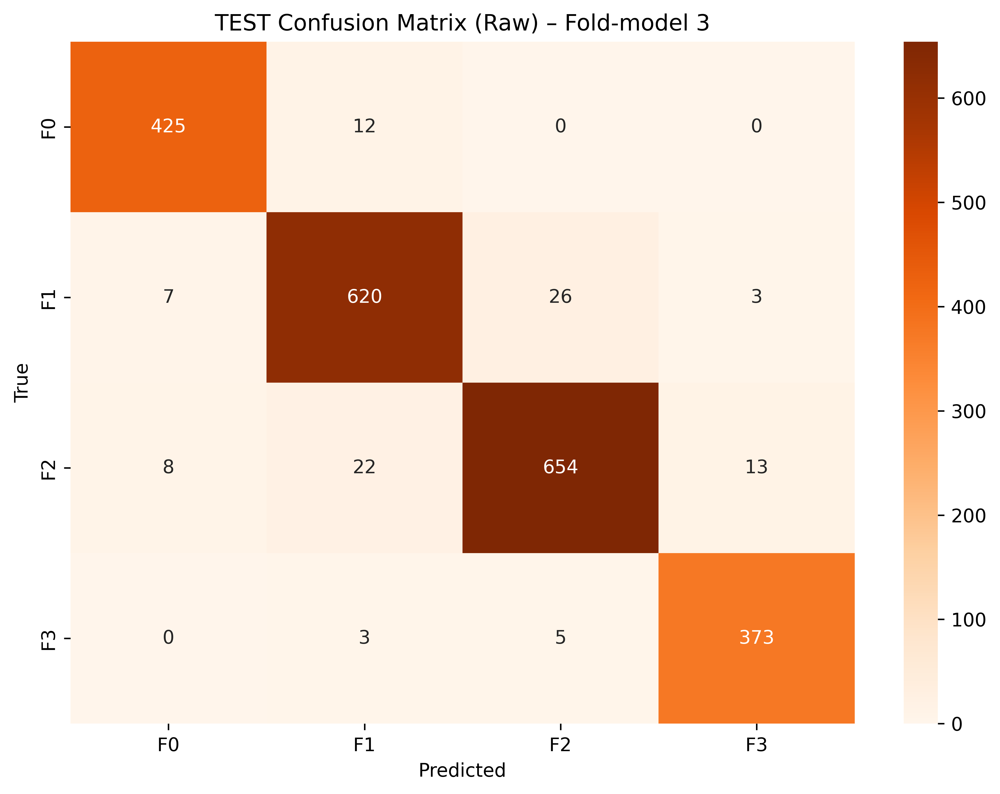

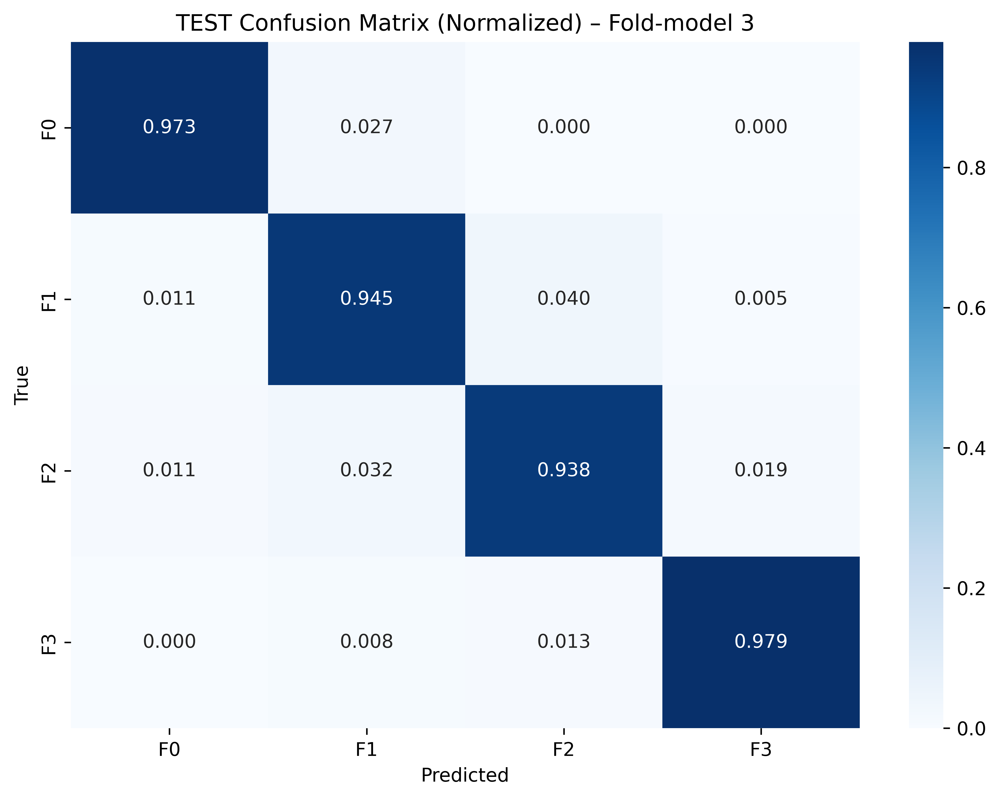


📄 Classification Report (Fold-model 3 on TEST):
              precision    recall  f1-score   support

          F0     0.9659    0.9725    0.9692       437
          F1     0.9437    0.9451    0.9444       656
          F2     0.9547    0.9383    0.9465       697
          F3     0.9589    0.9790    0.9688       381

    accuracy                         0.9544      2171
   macro avg     0.9558    0.9587    0.9572      2171
weighted avg     0.9544    0.9544    0.9543      2171


📊 OVERALL (Aggregated) TEST PERFORMANCE
⚠️ Note: This is NOT an ensemble. Test set is repeated across folds.
✅ Overall Accuracy: 0.9694
✅ Overall QWK:      0.9734


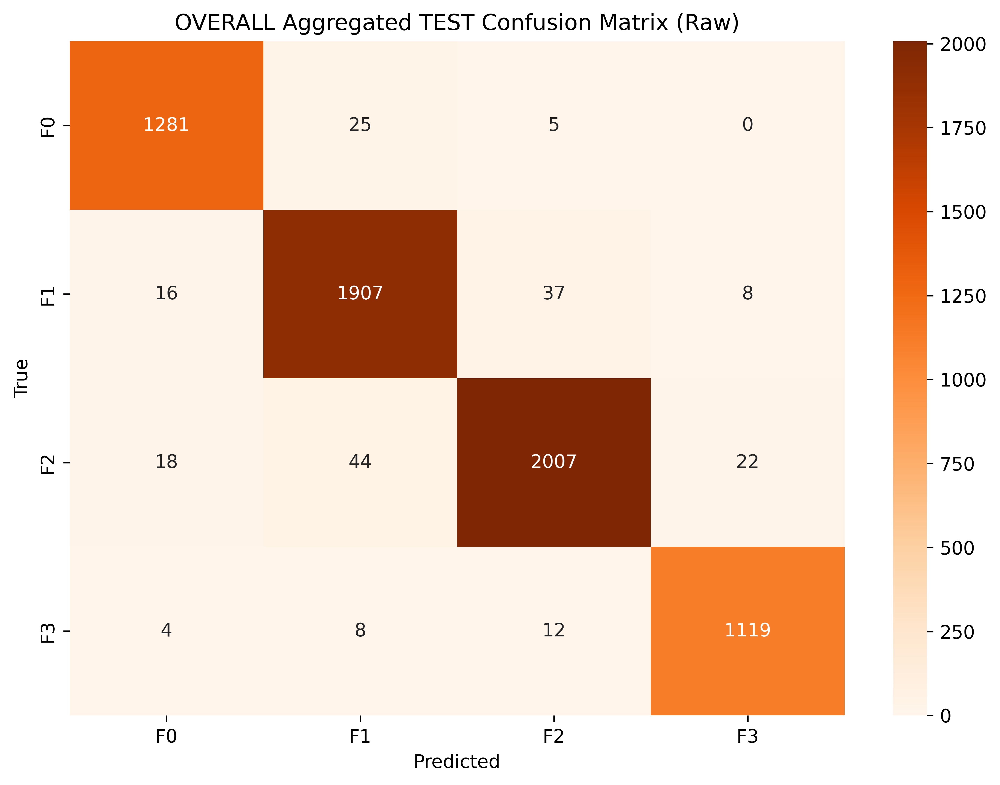

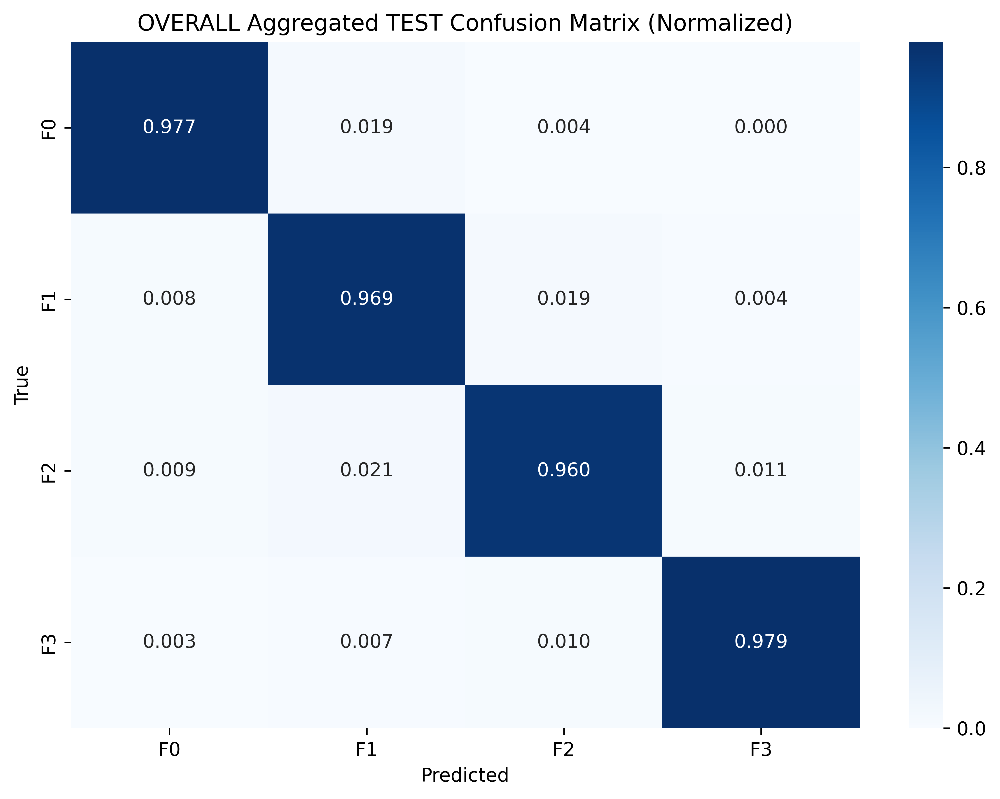


📄 Classification Report (OVERALL aggregated TEST):
              precision    recall  f1-score   support

          F0     0.9712    0.9771    0.9741      1311
          F1     0.9612    0.9690    0.9651      1968
          F2     0.9738    0.9598    0.9668      2091
          F3     0.9739    0.9790    0.9764      1143

    accuracy                         0.9694      6513
   macro avg     0.9700    0.9712    0.9706      6513
weighted avg     0.9695    0.9694    0.9694      6513



In [10]:
# ============================
# 1) LGCN + DenseNet (MRI): TEST SET RESULTS PER FOLD MODEL + OVERALL (600 DPI)
# (Fold-model-on-test; NOT CV validation)
# ============================

import os
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import torch
from torch.utils.data import DataLoader
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score, cohen_kappa_score

print("\n📌 LGCN + DenseNet (MRI): PER-FOLD (fold-model-on-test) + OVERALL (600 DPI)")

# ---- safety ----
if "test_df" not in globals():
    raise NameError("❌ test_df is not defined. Create held-out test_df first.")
if "DenseNetLGCN" not in globals():
    raise NameError("❌ DenseNetLGCN not found. Run the LGCN model definition cell first.")

# class names
class_names = list(class_map.keys()) if "class_map" in globals() else [f"F{i}" for i in range(CFG.NUM_CLASSES)]

# test loader
test_loader = DataLoader(
    LiverDataset(test_df, transform=valid_tfms),
    batch_size=CFG.BATCH_SIZE,
    shuffle=False,
    num_workers=2
)

# fold weight files
fold_models = [f"lgcn_fold{i+1}.pth" for i in range(CFG.N_SPLITS)]

all_true, all_pred = [], []

def load_lgcn_model(path):
    m = DenseNetLGCN(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)
    m.load_state_dict(torch.load(path, map_location=CFG.DEVICE))
    m.eval()
    return m

for fold, model_path in enumerate(fold_models, start=1):
    if not os.path.exists(model_path):
        print(f"\n⚠️ Skipping Fold-model {fold} (missing): {model_path}")
        continue

    print(f"\n🔹 Fold-model {fold} on TEST set...")
    model = load_lgcn_model(model_path)

    y_true_fold, y_pred_fold = [], []

    with torch.no_grad():
        for imgs, labels in test_loader:
            imgs = imgs.to(CFG.DEVICE)
            out = model(imgs)
            preds = out.argmax(dim=1).cpu().numpy()

            y_pred_fold.extend(preds)
            y_true_fold.extend(labels.numpy())

    fold_acc = accuracy_score(y_true_fold, y_pred_fold)
    fold_qwk = cohen_kappa_score(y_true_fold, y_pred_fold, weights="quadratic")

    print(f"✅ Fold {fold} TEST Accuracy: {fold_acc:.4f}")
    print(f"✅ Fold {fold} TEST QWK:      {fold_qwk:.4f}")

    # aggregate (note: test set repeated across folds → aggregated is NOT ensemble)
    all_true.extend(y_true_fold)
    all_pred.extend(y_pred_fold)

    # confusion matrix (raw)
    cm_raw = confusion_matrix(y_true_fold, y_pred_fold)
    plt.figure(figsize=(8, 6), dpi=600)
    sns.heatmap(cm_raw, annot=True, fmt="d", cmap="Oranges",
                xticklabels=class_names, yticklabels=class_names)
    plt.title(f"TEST Confusion Matrix (Raw) – Fold-model {fold}")
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.tight_layout()
    plt.show()

    # confusion matrix (normalized)
    cm_norm = cm_raw.astype(float) / (cm_raw.sum(axis=1, keepdims=True) + 1e-8)
    plt.figure(figsize=(8, 6), dpi=600)
    sns.heatmap(cm_norm, annot=True, fmt=".3f", cmap="Blues",
                xticklabels=class_names, yticklabels=class_names)
    plt.title(f"TEST Confusion Matrix (Normalized) – Fold-model {fold}")
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.tight_layout()
    plt.show()

    print(f"\n📄 Classification Report (Fold-model {fold} on TEST):")
    print(classification_report(y_true_fold, y_pred_fold, target_names=class_names, digits=4, zero_division=0))

# ---- aggregated overall (NOT ensemble) ----
all_true = np.array(all_true)
all_pred = np.array(all_pred)

if len(all_true) == 0:
    print("\n❌ No predictions collected. Check weight paths and test_loader.")
else:
    overall_acc = accuracy_score(all_true, all_pred)
    overall_qwk = cohen_kappa_score(all_true, all_pred, weights="quadratic")

    print("\n========================================")
    print("📊 OVERALL (Aggregated) TEST PERFORMANCE")
    print("⚠️ Note: This is NOT an ensemble. Test set is repeated across folds.")
    print(f"✅ Overall Accuracy: {overall_acc:.4f}")
    print(f"✅ Overall QWK:      {overall_qwk:.4f}")
    print("========================================")

    cm_overall = confusion_matrix(all_true, all_pred)

    plt.figure(figsize=(8, 6), dpi=600)
    sns.heatmap(cm_overall, annot=True, fmt="d", cmap="Oranges",
                xticklabels=class_names, yticklabels=class_names)
    plt.title("OVERALL Aggregated TEST Confusion Matrix (Raw)")
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.tight_layout()
    plt.show()

    cm_overall_norm = cm_overall.astype(float) / (cm_overall.sum(axis=1, keepdims=True) + 1e-8)
    plt.figure(figsize=(8, 6), dpi=600)
    sns.heatmap(cm_overall_norm, annot=True, fmt=".3f", cmap="Blues",
                xticklabels=class_names, yticklabels=class_names)
    plt.title("OVERALL Aggregated TEST Confusion Matrix (Normalized)")
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.tight_layout()
    plt.show()

    print("\n📄 Classification Report (OVERALL aggregated TEST):")
    print(classification_report(all_true, all_pred, target_names=class_names, digits=4, zero_division=0))



🚀 Evaluating MAIN TEST SET (Ensemble) — DenseNet + LGCN (MRI)...

📊 MAIN TEST SET RESULTS (ENSEMBLE) — DenseNet + LGCN (MRI)
✅ Test Accuracy: 0.9908
✅ Test QWK:      0.9908

📄 Classification Report:
              precision    recall  f1-score   support

          F0     0.9864    0.9977    0.9920       437
          F1     0.9893    0.9909    0.9901       656
          F2     0.9957    0.9857    0.9906       697
          F3     0.9895    0.9921    0.9908       381

    accuracy                         0.9908      2171
   macro avg     0.9902    0.9916    0.9909      2171
weighted avg     0.9908    0.9908    0.9908      2171



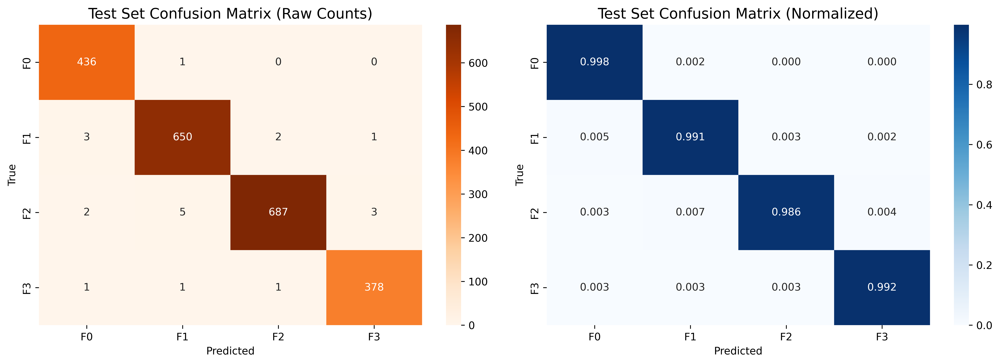


✅ Saved: test_confusion_matrix_ensemble_lgcn_mri.png
✅ all_probs saved for ROC/AUC cell.


In [12]:
# ============================
# 2) TEST SET EVALUATION (ENSEMBLE) — MAIN RESULT (LGCN + DenseNet MRI) (600 DPI)
# ============================

import os
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import torch
from torch.utils.data import DataLoader
from sklearn.metrics import accuracy_score, cohen_kappa_score, confusion_matrix, classification_report

print("\n🚀 Evaluating MAIN TEST SET (Ensemble) — DenseNet + LGCN (MRI)...")

# safety
if "test_df" not in globals():
    raise NameError("❌ test_df not defined.")
if "DenseNetLGCN" not in globals():
    raise NameError("❌ DenseNetLGCN not defined.")

test_loader = DataLoader(
    LiverDataset(test_df, transform=valid_tfms),
    batch_size=CFG.BATCH_SIZE,
    shuffle=False,
    num_workers=2
)

fold_models = [f"lgcn_fold{i+1}.pth" for i in range(CFG.N_SPLITS)]

# load models
models = []
for p in fold_models:
    if not os.path.exists(p):
        print(f"⚠️ Missing weight file: {p}")
        continue
    m = DenseNetLGCN(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)
    m.load_state_dict(torch.load(p, map_location=CFG.DEVICE))
    m.eval()
    models.append(m)

if len(models) == 0:
    raise FileNotFoundError("❌ No fold models loaded. Check lgcn_fold*.pth exist.")

class_names = list(class_map.keys()) if "class_map" in globals() else [f"F{i}" for i in range(CFG.NUM_CLASSES)]

# inference (store probs for ROC)
all_labels, all_preds, all_probs = [], [], []

with torch.no_grad():
    for imgs, labels in test_loader:
        imgs = imgs.to(CFG.DEVICE)

        probs = torch.zeros((imgs.size(0), CFG.NUM_CLASSES), device=CFG.DEVICE)
        for m in models:
            probs += torch.softmax(m(imgs), dim=1)
        probs /= len(models)

        preds = torch.argmax(probs, dim=1)

        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.numpy())
        all_probs.extend(probs.cpu().numpy())

all_labels = np.array(all_labels)
all_preds  = np.array(all_preds)
all_probs  = np.array(all_probs)

acc = accuracy_score(all_labels, all_preds)
qwk = cohen_kappa_score(all_labels, all_preds, weights="quadratic")

print("\n========================================")
print("📊 MAIN TEST SET RESULTS (ENSEMBLE) — DenseNet + LGCN (MRI)")
print(f"✅ Test Accuracy: {acc:.4f}")
print(f"✅ Test QWK:      {qwk:.4f}")
print("========================================")

print("\n📄 Classification Report:")
print(classification_report(all_labels, all_preds, target_names=class_names, digits=4, zero_division=0))

cm = confusion_matrix(all_labels, all_preds)

fig, ax = plt.subplots(1, 2, figsize=(14, 5), dpi=600)

sns.heatmap(cm, annot=True, fmt="d", cmap="Oranges",
            xticklabels=class_names, yticklabels=class_names, ax=ax[0])
ax[0].set_title("Test Set Confusion Matrix (Raw Counts)", fontsize=14)
ax[0].set_xlabel("Predicted"); ax[0].set_ylabel("True")

cm_norm = cm.astype(float) / (cm.sum(axis=1, keepdims=True) + 1e-8)
sns.heatmap(cm_norm, annot=True, fmt=".3f", cmap="Blues",
            xticklabels=class_names, yticklabels=class_names, ax=ax[1])
ax[1].set_title("Test Set Confusion Matrix (Normalized)", fontsize=14)
ax[1].set_xlabel("Predicted"); ax[1].set_ylabel("True")

plt.tight_layout()
plt.show()

fig.savefig("test_confusion_matrix_ensemble_lgcn_mri.png", dpi=600, bbox_inches="tight")
print("\n✅ Saved: test_confusion_matrix_ensemble_lgcn_mri.png")
print("✅ all_probs saved for ROC/AUC cell.")


🚀 Generating ROC/AUC Curves (MRI)...

📊 ROC/AUC RESULTS (TEST SET) — DenseNet + LGCN (MRI)
✅ Micro-average AUC: 0.9999
✅ Macro-average AUC: 0.9999
   - F0 AUC: 1.0000
   - F1 AUC: 0.9999
   - F2 AUC: 0.9998
   - F3 AUC: 0.9999


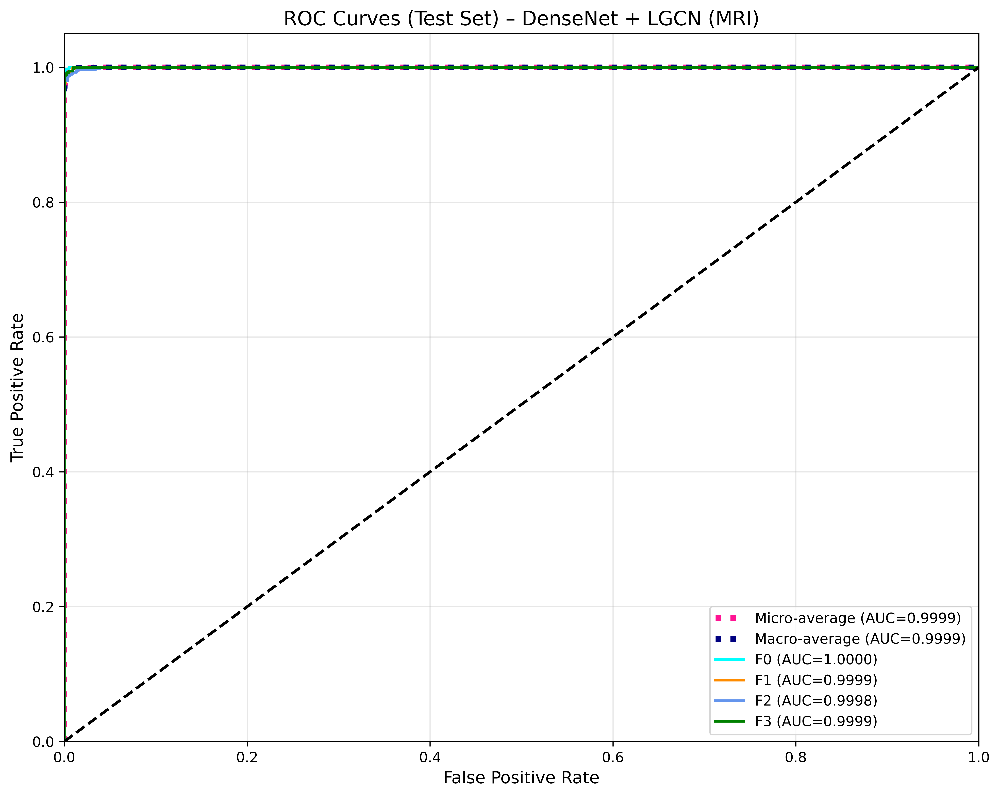

✅ Saved: roc_auc_densenet_lgcn_mri_test.png


In [13]:
# ============================
# 3) ROC/AUC CURVES (LGCN + DenseNet MRI) — 600 DPI
# ============================

from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
from itertools import cycle
import numpy as np
import matplotlib.pyplot as plt

print("🚀 Generating ROC/AUC Curves (MRI)...")

if "all_probs" not in globals() or "all_labels" not in globals():
    raise NameError("❌ Run the ENSEMBLE TEST evaluation cell first to create all_probs and all_labels.")

y_test  = label_binarize(all_labels, classes=range(CFG.NUM_CLASSES))
y_score = all_probs
n_classes = y_test.shape[1]

fpr, tpr, roc_auc = {}, {}, {}
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# micro
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# macro
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
mean_tpr /= n_classes
fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

class_names = list(class_map.keys()) if "class_map" in globals() else [f"F{i}" for i in range(CFG.NUM_CLASSES)]

print("\n========================================")
print("📊 ROC/AUC RESULTS (TEST SET) — DenseNet + LGCN (MRI)")
print(f"✅ Micro-average AUC: {roc_auc['micro']:.4f}")
print(f"✅ Macro-average AUC: {roc_auc['macro']:.4f}")
for i in range(n_classes):
    print(f"   - {class_names[i]} AUC: {roc_auc[i]:.4f}")
print("========================================")

fig = plt.figure(figsize=(10, 8), dpi=600)

plt.plot(fpr["micro"], tpr["micro"],
         label=f"Micro-average (AUC={roc_auc['micro']:.4f})",
         color="deeppink", linestyle=":", lw=4)

plt.plot(fpr["macro"], tpr["macro"],
         label=f"Macro-average (AUC={roc_auc['macro']:.4f})",
         color="navy", linestyle=":", lw=4)

colors = cycle(["aqua", "darkorange", "cornflowerblue", "green"])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f"{class_names[i]} (AUC={roc_auc[i]:.4f})")

plt.plot([0, 1], [0, 1], "k--", lw=2)
plt.xlim([0.0, 1.0]); plt.ylim([0.0, 1.05])
plt.xlabel("False Positive Rate", fontsize=12)
plt.ylabel("True Positive Rate", fontsize=12)
plt.title("ROC Curves (Test Set) – DenseNet + LGCN (MRI)", fontsize=14)
plt.legend(loc="lower right", fontsize=10)
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()

fig.savefig("roc_auc_densenet_lgcn_mri_test.png", dpi=600, bbox_inches="tight")
print("✅ Saved: roc_auc_densenet_lgcn_mri_test.png")


In [14]:
# ============================
# 4) ENSEMBLE INTERFACE TEST — helper
# ============================

import os, torch
import numpy as np

print("✅ Building ensemble_lgcn() helper...")

fold_models = [f"lgcn_fold{i+1}.pth" for i in range(CFG.N_SPLITS)]

lgcn_models = []
for p in fold_models:
    if not os.path.exists(p):
        print(f"⚠️ Missing: {p}")
        continue
    m = DenseNetLGCN(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)
    m.load_state_dict(torch.load(p, map_location=CFG.DEVICE))
    m.eval()
    lgcn_models.append(m)

if len(lgcn_models) == 0:
    raise FileNotFoundError("❌ No LGCN fold weights found: lgcn_fold*.pth")

@torch.no_grad()
def ensemble_lgcn(x):
    """
    x: (B,3,224,224)
    returns: probs (B,num_classes)
    """
    probs = torch.zeros((x.size(0), CFG.NUM_CLASSES), device=CFG.DEVICE)
    for m in lgcn_models:
        probs += torch.softmax(m(x), dim=1)
    probs /= len(lgcn_models)
    return probs


✅ Building ensemble_lgcn() helper...



🔍 Testing 4 random images per class → total 16 images (4×4)


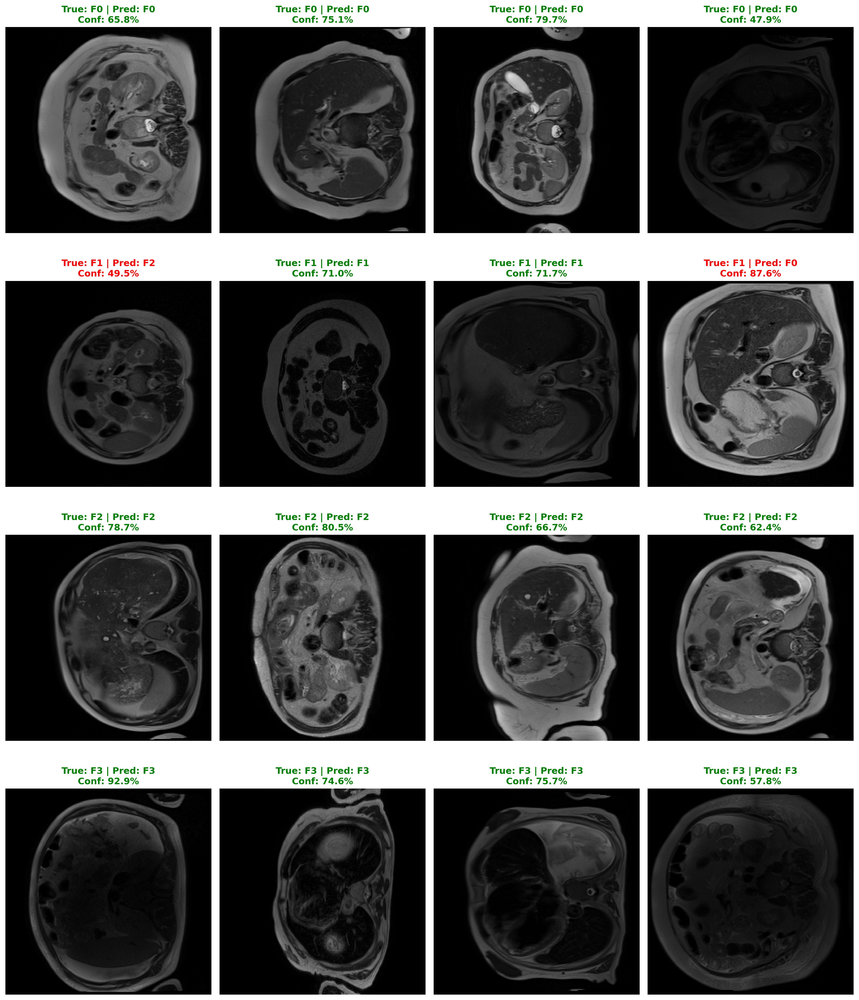

In [15]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def predict_interface_k_per_class(df_data, k=4, dpi=300, seed=42):
    np.random.seed(seed)

    class_names = list(class_map.keys()) if "class_map" in globals() else [f"F{i}" for i in range(CFG.NUM_CLASSES)]

    rows = []
    for c in range(CFG.NUM_CLASSES):
        sub = df_data[df_data["diagnosis"] == c]
        if len(sub) == 0:
            print(f"⚠️ No samples for class {class_names[c]} in this df, skipping.")
            continue
        take = min(k, len(sub))
        sampled = sub.sample(take, random_state=np.random.randint(0, 100000))
        rows.extend(sampled.to_dict("records"))

    if len(rows) == 0:
        print("❌ No samples collected.")
        return

    n = len(rows)
    ncols = k
    nrows = int(np.ceil(n / ncols))

    print(f"\n🔍 Testing {k} random images per class → total {n} images ({nrows}×{ncols})")

    fig, axes = plt.subplots(nrows, ncols, figsize=(4*ncols, 4.8*nrows), dpi=dpi)
    axes = np.array(axes).reshape(nrows, ncols)

    idx = 0
    for r in range(nrows):
        for ccol in range(ncols):
            ax = axes[r, ccol]
            if idx >= n:
                ax.axis("off")
                continue

            row = rows[idx]; idx += 1

            img = cv2.imread(row["image_path"])
            if img is None:
                ax.axis("off"); continue

            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            img = cv2.resize(img, (CFG.IMG_SIZE, CFG.IMG_SIZE))

            t = valid_tfms(image=img)["image"].unsqueeze(0).to(CFG.DEVICE)

            p = ensemble_lgcn(t)[0].cpu().numpy()
            pred = int(np.argmax(p))
            conf = float(p[pred] * 100.0)
            true = int(row["diagnosis"])

            col = "green" if pred == true else "red"
            ax.imshow(img)
            ax.set_title(
                f"True: {class_names[true]} | Pred: {class_names[pred]}\nConf: {conf:.1f}%",
                color=col, fontweight="bold"
            )
            ax.axis("off")

    plt.tight_layout()
    plt.show()

# ✅ Run interface test
predict_interface_k_per_class(test_df, k=4, dpi=300, seed=42)


 Generating Graph Structure Visualization...


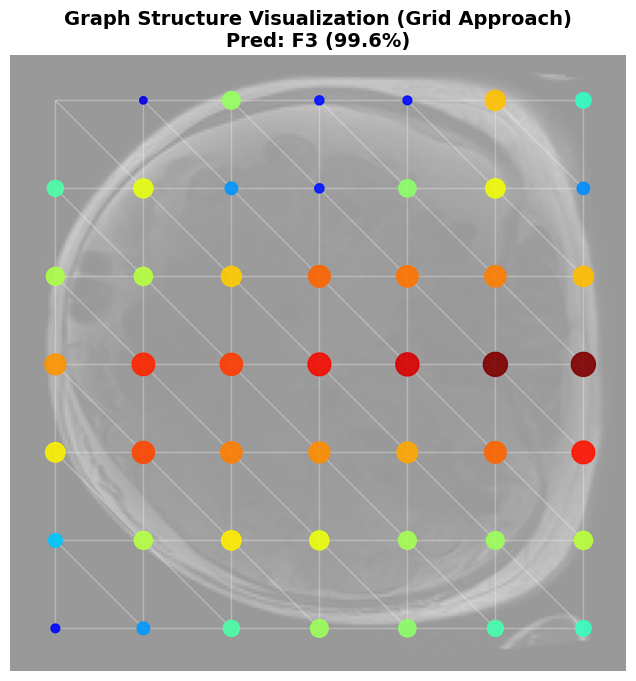

In [16]:
# --- CELL: VISUALIZE GRID AS A GRAPH (NODES & EDGES) ---
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
import cv2
import torch

def visualize_grid_graph_structure(model, img_path):
    model.eval()
    
    # 1. Prepare Image
    img = preprocess_for_model(img_path)
    input_tensor = valid_tfms(image=img)["image"].unsqueeze(0).to(CFG.DEVICE)
    
    # Load Original for Display
    orig_img = cv2.imread(img_path)
    orig_img = cv2.cvtColor(orig_img, cv2.COLOR_BGR2RGB)
    orig_img = cv2.resize(orig_img, (CFG.IMG_SIZE, CFG.IMG_SIZE))
    
    # 2. Get Graph Activations (Node Strengths)
    with torch.no_grad():
        logits = model(input_tensor)
        probs = torch.softmax(logits, dim=1)[0]
        pred_idx = torch.argmax(probs).item()
        
        # Get the feature map (The Grid)
        # We use the hook we added earlier: get_graph_activations
        activation_map = model.get_graph_activations(input_tensor) # Shape: (1, H, W)
        
    # 3. Build the NetworkX Graph
    # H, W is usually 7x7 or 8x8 for DenseNet
    H, W = activation_map.shape[1], activation_map.shape[2]
    
    # Normalize Activations to 0-1 for Color/Size
    node_weights = activation_map[0].cpu().numpy().flatten()
    node_weights = (node_weights - node_weights.min()) / (node_weights.max() - node_weights.min())
    
    G = nx.Graph()
    
    # Scale grid coordinates to image pixels
    step_y = CFG.IMG_SIZE / H
    step_x = CFG.IMG_SIZE / W
    
    # Add Nodes (Centered in their grid block)
    for r in range(H):
        for c in range(W):
            node_id = r * W + c
            # Calculate center (x, y) of this grid block
            pos_x = (c * step_x) + (step_x / 2)
            pos_y = (r * step_y) + (step_y / 2)
            
            # Flip Y for NetworkX plotting (Standard fix)
            # Actually, imshow plots 0,0 at top-left, so we just use image coords directly
            G.add_node(node_id, pos=(pos_x, pos_y), weight=node_weights[node_id])
            
            # Add Edges (Connect to Right and Bottom neighbors to make a grid)
            # Right Neighbor
            if c < W - 1:
                right_id = r * W + (c + 1)
                G.add_edge(node_id, right_id)
            # Bottom Neighbor
            if r < H - 1:
                bottom_id = (r + 1) * W + c
                G.add_edge(node_id, bottom_id)
                
            # (Optional) Diagonals for 8-neighbor look
            if r < H - 1 and c < W - 1:
                diag_id = (r + 1) * W + (c + 1)
                G.add_edge(node_id, diag_id)

    # 4. Plotting
    plt.figure(figsize=(8, 8))
    
    # Draw Faded Background Image
    plt.imshow(orig_img, alpha=0.4)
    
    # Get Positions
    pos = nx.get_node_attributes(G, 'pos')
    
    # Draw Edges (Thin grey lines)
    nx.draw_networkx_edges(G, pos, edge_color='white', alpha=0.3, width=1.0)
    
    # Draw Nodes (Colored by Importance)
    # Red = High Activation (Fibrosis Focus), Blue = Low Activation
    nx.draw_networkx_nodes(G, pos, 
                           node_size=node_weights * 300, # Size scales with importance
                           node_color=node_weights, 
                           cmap=plt.cm.jet, 
                           alpha=0.9)
    
    # Prediction Title
    idx_to_class = {0: 'F0', 1: 'F1', 2: 'F2', 3: 'F3'}
    pred_label = idx_to_class[pred_idx]
    conf = probs[pred_idx].item() * 100
    
    plt.title(f"Graph Structure Visualization (Grid Approach)\nPred: {pred_label} ({conf:.1f}%)", fontsize=14, fontweight='bold')
    plt.axis('off')
    plt.show()

# --- TEST IT ---
print(" Generating Graph Structure Visualization...")
# Pick a random sample
import random
random_idx = random.randint(0, len(df)-1)
sample_row = df.iloc[random_idx]
visualize_grid_graph_structure(model, sample_row.image_path)

🚀 Generating 6-Panel XAI for DenseNet121 + LGCN (MRI)...

--- True: F0 | Pred: F0 (54.5%) ---


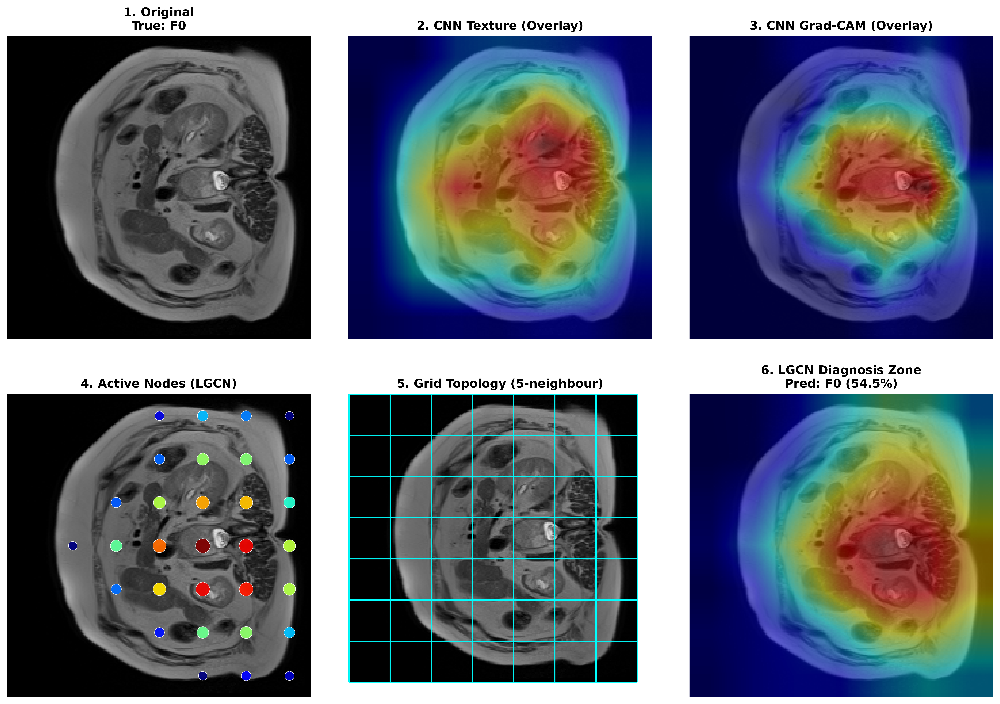


--- True: F1 | Pred: F2 (45.0%) ---


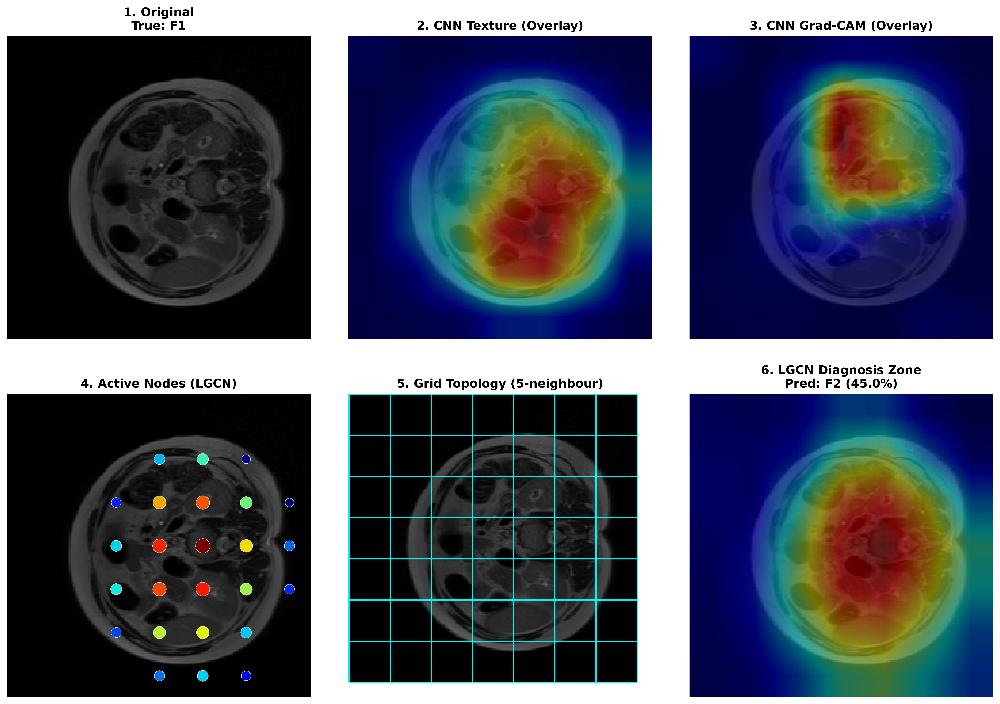


--- True: F2 | Pred: F2 (50.8%) ---


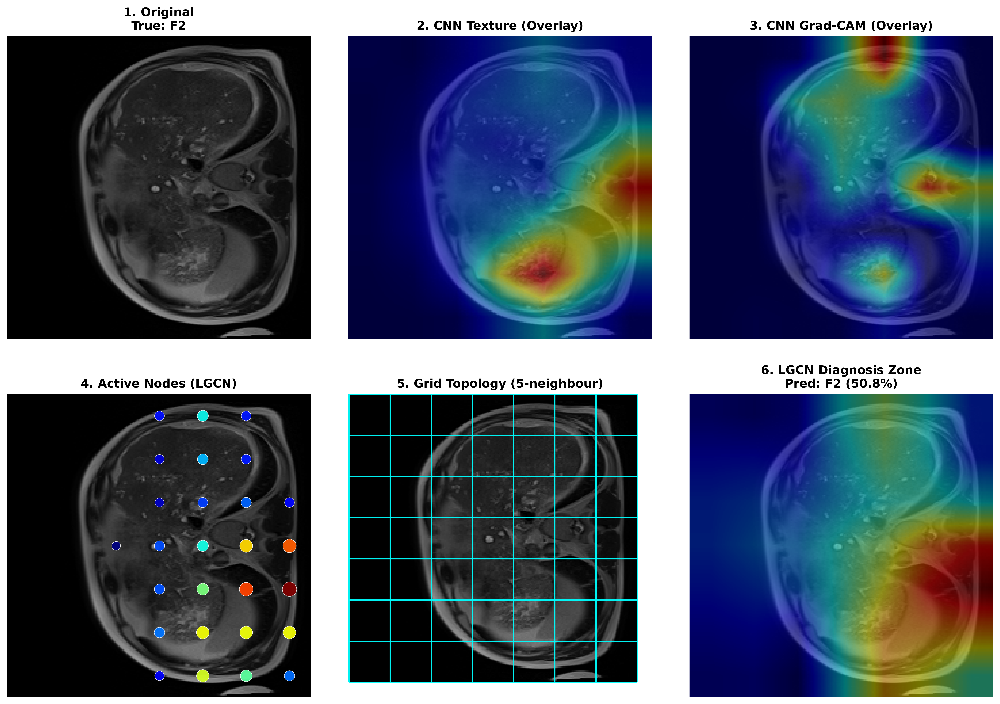


--- True: F3 | Pred: F3 (87.2%) ---


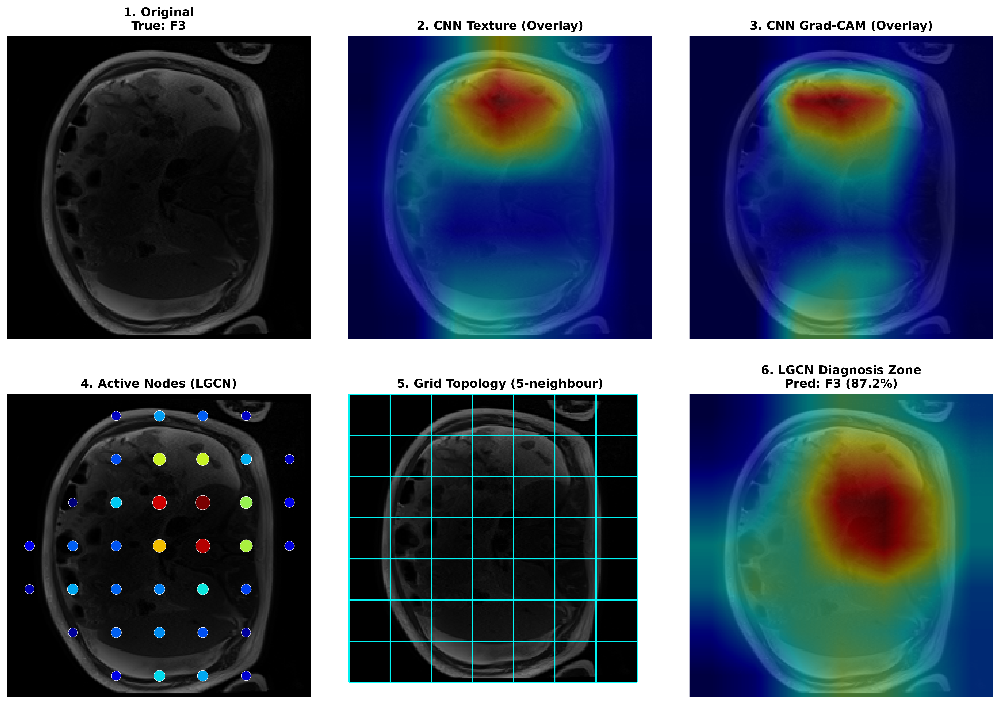

In [17]:
# ============================
# 5A) 6-PANEL XAI VISUALIZATION (DenseNet + LGCN MRI)
# - Panel 5: TRUE GRID LINES (CLEAR + VISIBLE)
# - Graph map: model.get_graph_activations()
# ============================

import os, cv2, numpy as np, matplotlib.pyplot as plt
import torch
import torch.nn.functional as F

print("🚀 Generating 6-Panel XAI for DenseNet121 + LGCN (MRI)...")

def pick_df_for_xai():
    if "test_df" in globals(): return test_df
    if "train_df" in globals(): return train_df
    if "df" in globals(): return df
    raise NameError("❌ No dataframe found. Define one of: test_df / train_df / df")

df_use = pick_df_for_xai()
class_names = list(class_map.keys()) if "class_map" in globals() else [f"F{i}" for i in range(CFG.NUM_CLASSES)]

def overlay_heatmap_on_image(img_rgb, heatmap_01, alpha=0.4, colormap=cv2.COLORMAP_JET):
    heat = np.uint8(255 * np.clip(heatmap_01, 0, 1))
    heat_color = cv2.applyColorMap(heat, colormap)  # BGR
    heat_color = cv2.cvtColor(heat_color, cv2.COLOR_BGR2RGB)
    return cv2.addWeighted(img_rgb, 1 - alpha, heat_color, alpha, 0)

def extract_lgcn_xai(model, img_tensor, true_label=None):
    model.eval()
    model.zero_grad()

    fmaps, grads = [], []

    def hook(module, inp, out):
        if torch.is_tensor(out):
            fmaps.append(out)
            out.register_hook(lambda g: grads.append(g))

    if not hasattr(model, "cnn"):
        raise AttributeError("❌ model.cnn not found.")

    hook_target = model.cnn.features if hasattr(model.cnn, "features") else model.cnn
    h = hook_target.register_forward_hook(hook)

    with torch.set_grad_enabled(True):
        logits = model(img_tensor)
        probs  = torch.softmax(logits, dim=1)
        pred   = logits.argmax(1).item()
        conf   = probs[0, pred].item()

        target = pred if true_label is None else int(true_label)
        logits[0, target].backward()

    h.remove()

    if len(fmaps) == 0 or len(grads) == 0:
        raise RuntimeError("❌ Hook failed to capture feature maps/gradients.")

    fmap = fmaps[0].detach()  # [B,C,H,W]
    grad = grads[0].detach()  # [B,C,H,W]
    B, C, Hf, Wf = fmap.shape

    # Texture map
    tex = torch.mean(fmap, dim=1).squeeze().cpu().numpy()
    tex = (tex - tex.min()) / (tex.max() - tex.min() + 1e-8)

    # Grad-CAM
    w = torch.mean(grad, dim=(2, 3), keepdim=True)
    cam = torch.sum(w * fmap, dim=1).squeeze()
    cam = F.relu(cam).cpu().numpy()
    cam = (cam - cam.min()) / (cam.max() - cam.min() + 1e-8)

    # LGCN graph activations
    with torch.no_grad():
        gact = model.get_graph_activations(img_tensor).squeeze().cpu().numpy()  # [Hf,Wf]
        gact = (gact - gact.min()) / (gact.max() - gact.min() + 1e-8)

    return tex, cam, gact, pred, conf, Hf, Wf

def plot_lgcn_6_panel(img, tex, cam, gact, true_y, pred_y, conf, Hf, Wf, dpi=600):
    fig, ax = plt.subplots(2, 3, figsize=(18, 12), dpi=dpi)
    plt.subplots_adjust(wspace=0.08, hspace=0.18)

    sz = (CFG.IMG_SIZE, CFG.IMG_SIZE)
    tex_rs  = cv2.resize(tex,  sz)
    cam_rs  = cv2.resize(cam,  sz)
    gact_rs = cv2.resize(gact, sz)

    tex_overlay  = overlay_heatmap_on_image(img, tex_rs,  alpha=0.45)
    cam_overlay  = overlay_heatmap_on_image(img, cam_rs,  alpha=0.45)
    gact_overlay = overlay_heatmap_on_image(img, gact_rs, alpha=0.45)

    font = {'weight': 'bold', 'size': 12}

    ax[0,0].imshow(img)
    ax[0,0].set_title(f"1. Original\nTrue: {class_names[true_y]}", font)

    ax[0,1].imshow(tex_overlay)
    ax[0,1].set_title("2. CNN Texture (Overlay)", font)

    ax[0,2].imshow(cam_overlay)
    ax[0,2].set_title("3. CNN Grad-CAM (Overlay)", font)

    ax[1,0].imshow(img)
    flat = gact.flatten()
    mask = flat > 0.25
    # node centers
    xs = (np.arange(Wf) + 0.5) * (CFG.IMG_SIZE / Wf)
    ys = (np.arange(Hf) + 0.5) * (CFG.IMG_SIZE / Hf)
    X, Y = np.meshgrid(xs, ys)
    Xf, Yf = X.flatten(), Y.flatten()
    sizes = 30 + flat[mask] * 180
    ax[1,0].scatter(Xf[mask], Yf[mask], c=flat[mask], s=sizes, cmap="jet",
                    alpha=0.95, edgecolors="white", linewidths=0.4, zorder=10)
    ax[1,0].set_title("4. Active Nodes (LGCN)", font)

    # Panel 5: TRUE grid lines
    ax[1,1].imshow(img, alpha=1.0)
    step_x = CFG.IMG_SIZE / Wf
    step_y = CFG.IMG_SIZE / Hf
    xs = np.arange(0, CFG.IMG_SIZE + 1e-6, step_x)
    ys = np.arange(0, CFG.IMG_SIZE + 1e-6, step_y)
    ax[1,1].vlines(xs, 0, CFG.IMG_SIZE, colors="cyan", linewidth=1.2, alpha=0.95, zorder=10)
    ax[1,1].hlines(ys, 0, CFG.IMG_SIZE, colors="cyan", linewidth=1.2, alpha=0.95, zorder=10)
    ax[1,1].set_title("5. Grid Topology (5-neighbour)", font)

    ax[1,2].imshow(gact_overlay)
    ax[1,2].set_title(f"6. LGCN Diagnosis Zone\nPred: {class_names[pred_y]} ({conf*100:.1f}%)", font)

    for a in ax.flatten():
        a.axis("off")
    plt.show()

# -------------------------------
# Load one fold model (Fold 1) for XAI
# -------------------------------
weights_path = "lgcn_fold1.pth"
if not os.path.exists(weights_path):
    raise FileNotFoundError(f"❌ Missing weights: {weights_path}")

model = DenseNetLGCN(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)
model.load_state_dict(torch.load(weights_path, map_location=CFG.DEVICE))
model.eval()

# -------------------------------
# Run random examples (1 per class)
# -------------------------------
np.random.seed(42)
for c in range(CFG.NUM_CLASSES):
    sub = df_use[df_use["diagnosis"] == c]
    if len(sub) == 0:
        print(f"⚠️ No samples for {class_names[c]}, skipping.")
        continue

    row = sub.sample(1, random_state=np.random.randint(0, 100000)).iloc[0]
    img = cv2.cvtColor(cv2.imread(row.image_path), cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (CFG.IMG_SIZE, CFG.IMG_SIZE))

    t = valid_tfms(image=img)["image"].unsqueeze(0).to(CFG.DEVICE)
    tex, cam, gact, pred, conf, Hf, Wf = extract_lgcn_xai(model, t, true_label=c)

    print(f"\n--- True: {class_names[c]} | Pred: {class_names[pred]} ({conf*100:.1f}%) ---")
    plot_lgcn_6_panel(img, tex, cam, gact, true_y=c, pred_y=pred, conf=conf, Hf=Hf, Wf=Wf, dpi=600)


🚀 Generating 6-Panel XAI for DenseNet121 + LGCN (MRI) — Graph Panel 5...

--- True: F0 | Pred: F0 (54.5%) ---


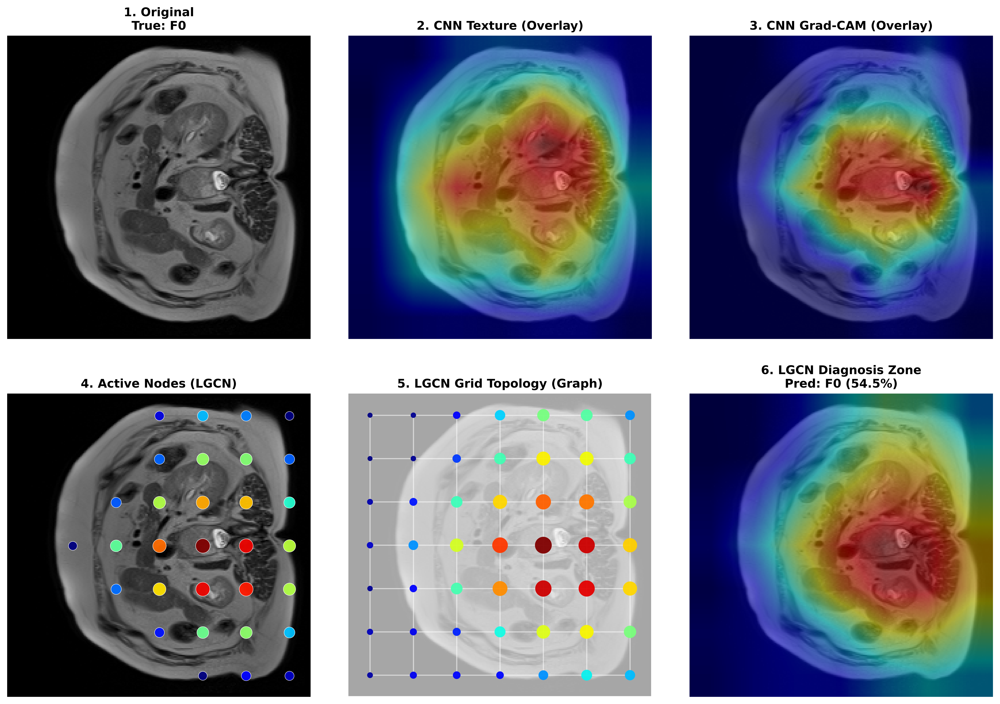


--- True: F1 | Pred: F2 (45.0%) ---


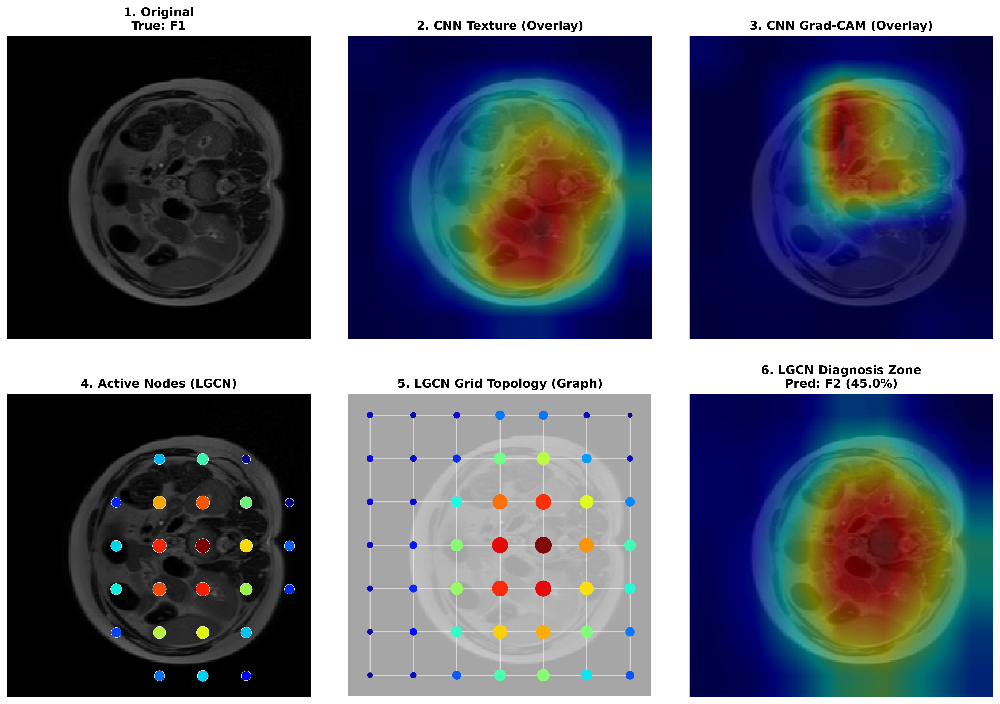


--- True: F2 | Pred: F2 (50.8%) ---


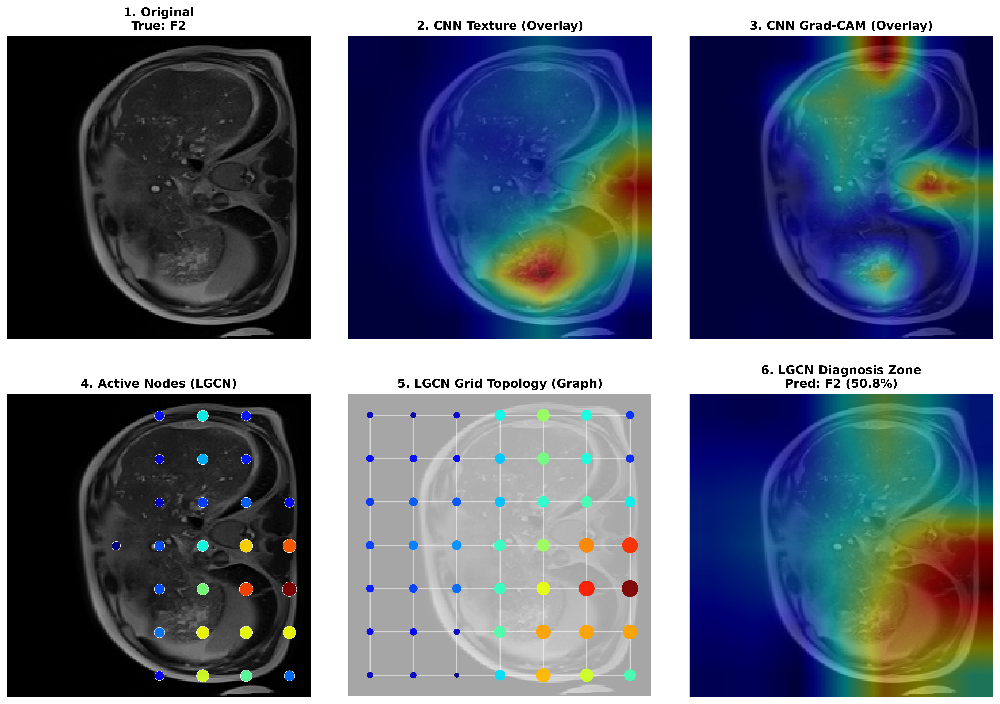


--- True: F3 | Pred: F3 (87.2%) ---


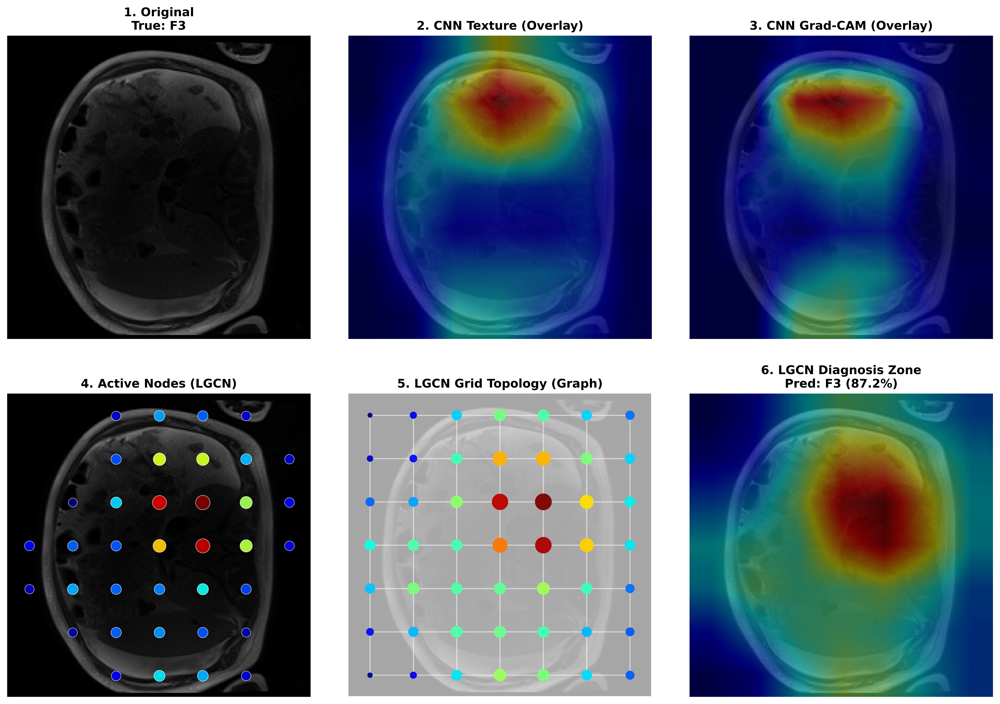

In [19]:
# ============================
# 5B) 6-PANEL XAI VISUALIZATION (DenseNet + LGCN MRI) — PANEL 5 LIKE YOUR PICTURE
# - Panel 5: Grid graph + colored nodes (size+color from LGCN graph activations)
# ============================

import os, cv2, numpy as np, matplotlib.pyplot as plt
import torch
import torch.nn.functional as F
import networkx as nx

print("🚀 Generating 6-Panel XAI for DenseNet121 + LGCN (MRI) — Graph Panel 5...")

def pick_df_for_xai():
    if "test_df" in globals(): return test_df
    if "train_df" in globals(): return train_df
    if "df" in globals(): return df
    raise NameError("❌ No dataframe found. Define one of: test_df / train_df / df")

df_use = pick_df_for_xai()
class_names = list(class_map.keys()) if "class_map" in globals() else [f"F{i}" for i in range(CFG.NUM_CLASSES)]

def norm01(x):
    x = np.asarray(x, dtype=np.float32)
    return (x - x.min()) / (x.max() - x.min() + 1e-8)

def overlay_heatmap_on_image(img_rgb, heatmap_01, alpha=0.4, colormap=cv2.COLORMAP_JET):
    heat = np.uint8(255 * np.clip(heatmap_01, 0, 1))
    heat_color = cv2.applyColorMap(heat, colormap)
    heat_color = cv2.cvtColor(heat_color, cv2.COLOR_BGR2RGB)
    return cv2.addWeighted(img_rgb, 1 - alpha, heat_color, alpha, 0)

def build_grid_graph(H, W, node_weights_01, img_size=224):
    """
    Draw a grid (right + down edges) with positions over 224x224
    node_weights_01: [H,W] normalized importance
    """
    G = nx.Graph()
    for r in range(H):
        for c in range(W):
            nid = r * W + c
            px = (c + 0.5) * (img_size / W)
            py = (r + 0.5) * (img_size / H)

            G.add_node(nid, pos=(px, py), weight=float(node_weights_01[r, c]))

            if c + 1 < W: G.add_edge(nid, nid + 1)
            if r + 1 < H: G.add_edge(nid, nid + W)
    return G

def extract_lgcn_xai(model, img_tensor, true_label=None):
    model.eval()
    model.zero_grad()

    fmaps, grads = [], []

    def hook(module, inp, out):
        if torch.is_tensor(out):
            fmaps.append(out)
            out.register_hook(lambda g: grads.append(g))

    hook_target = model.cnn.features if hasattr(model.cnn, "features") else model.cnn
    h = hook_target.register_forward_hook(hook)

    with torch.set_grad_enabled(True):
        logits = model(img_tensor)
        probs  = torch.softmax(logits, dim=1)
        pred   = logits.argmax(1).item()
        conf   = probs[0, pred].item()

        target = pred if true_label is None else int(true_label)
        logits[0, target].backward()

    h.remove()

    fmap = fmaps[0].detach()
    grad = grads[0].detach()
    B, C, Hf, Wf = fmap.shape

    tex = torch.mean(fmap, dim=1).squeeze().cpu().numpy()
    tex = norm01(tex)

    w = torch.mean(grad, dim=(2, 3), keepdim=True)
    cam = torch.sum(w * fmap, dim=1).squeeze()
    cam = F.relu(cam).cpu().numpy()
    cam = norm01(cam)

    with torch.no_grad():
        gact = model.get_graph_activations(img_tensor).squeeze().cpu().numpy()
        gact = norm01(gact)

    return tex, cam, gact, pred, conf, Hf, Wf

def plot_lgcn_6_panel(img, tex, cam, gact, true_y, pred_y, conf, Hf, Wf, dpi=600):
    fig, ax = plt.subplots(2, 3, figsize=(18, 12), dpi=dpi)
    plt.subplots_adjust(wspace=0.08, hspace=0.18)

    sz = (CFG.IMG_SIZE, CFG.IMG_SIZE)
    tex_rs  = cv2.resize(tex,  sz)
    cam_rs  = cv2.resize(cam,  sz)
    gact_rs = cv2.resize(gact, sz)

    tex_overlay  = overlay_heatmap_on_image(img, tex_rs,  alpha=0.45)
    cam_overlay  = overlay_heatmap_on_image(img, cam_rs,  alpha=0.45)
    gact_overlay = overlay_heatmap_on_image(img, gact_rs, alpha=0.45)

    font = {'weight': 'bold', 'size': 12}

    ax[0,0].imshow(img)
    ax[0,0].set_title(f"1. Original\nTrue: {class_names[true_y]}", font)

    ax[0,1].imshow(tex_overlay)
    ax[0,1].set_title("2. CNN Texture (Overlay)", font)

    ax[0,2].imshow(cam_overlay)
    ax[0,2].set_title("3. CNN Grad-CAM (Overlay)", font)

    # 4) active nodes
    ax[1,0].imshow(img)
    xs = (np.arange(Wf) + 0.5) * (CFG.IMG_SIZE / Wf)
    ys = (np.arange(Hf) + 0.5) * (CFG.IMG_SIZE / Hf)
    X, Y = np.meshgrid(xs, ys)
    flat = gact.flatten()
    mask = flat > 0.25
    sizes = 30 + flat[mask] * 180
    ax[1,0].scatter(X.flatten()[mask], Y.flatten()[mask], c=flat[mask], s=sizes, cmap="jet",
                    alpha=0.95, edgecolors="white", linewidths=0.4, zorder=10)
    ax[1,0].set_title("4. Active Nodes (LGCN)", font)

    # 5) graph topology like picture
    ax[1,1].imshow(img, alpha=0.35)
    G = build_grid_graph(Hf, Wf, gact, img_size=CFG.IMG_SIZE)
    pos = nx.get_node_attributes(G, "pos")
    ws  = np.array([G.nodes[n]["weight"] for n in G.nodes], dtype=np.float32)

    nx.draw_networkx_edges(G, pos, ax=ax[1,1], edge_color="white", alpha=0.55, width=1.1)
    node_sizes = 25 + ws * 260
    nx.draw_networkx_nodes(G, pos, ax=ax[1,1],
                           node_size=node_sizes,
                           node_color=ws, cmap=plt.cm.jet,
                           alpha=0.95, linewidths=0.0)

    ax[1,1].set_title("5. LGCN Grid Topology (Graph)", fontsize=12, fontweight="bold")
    ax[1,1].set_ylim(CFG.IMG_SIZE, 0)
    ax[1,1].set_xlim(0, CFG.IMG_SIZE)

    # 6) diagnosis overlay
    ax[1,2].imshow(gact_overlay)
    ax[1,2].set_title(f"6. LGCN Diagnosis Zone\nPred: {class_names[pred_y]} ({conf*100:.1f}%)", font)

    for a in ax.flatten():
        a.axis("off")
    plt.show()

# load fold1 weights
weights_path = "lgcn_fold1.pth"
if not os.path.exists(weights_path):
    raise FileNotFoundError(f"❌ Missing weights: {weights_path}")

model = DenseNetLGCN(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)
model.load_state_dict(torch.load(weights_path, map_location=CFG.DEVICE))
model.eval()

np.random.seed(42)
for c in range(CFG.NUM_CLASSES):
    sub = df_use[df_use["diagnosis"] == c]
    if len(sub) == 0:
        print(f"⚠️ No samples for {class_names[c]}, skipping.")
        continue

    row = sub.sample(1, random_state=np.random.randint(0, 100000)).iloc[0]
    img = cv2.cvtColor(cv2.imread(row.image_path), cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (CFG.IMG_SIZE, CFG.IMG_SIZE))

    t = valid_tfms(image=img)["image"].unsqueeze(0).to(CFG.DEVICE)
    tex, cam, gact, pred, conf, Hf, Wf = extract_lgcn_xai(model, t, true_label=c)

    print(f"\n--- True: {class_names[c]} | Pred: {class_names[pred]} ({conf*100:.1f}%) ---")
    plot_lgcn_6_panel(img, tex, cam, gact, true_y=c, pred_y=pred, conf=conf, Hf=Hf, Wf=Wf, dpi=600)


🚀 Generating 6-Panel XAI for DenseNet121 + LGCN (MRI) — Graph Panel 5...

--- True: F0 | Pred: F0 (54.5%) ---


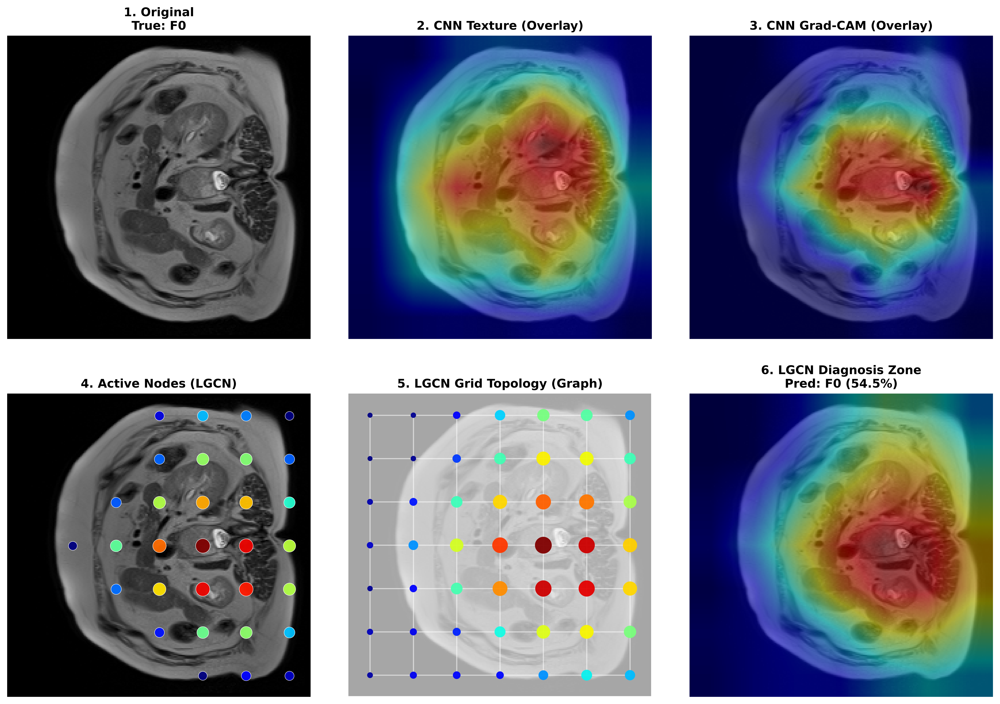


--- True: F1 | Pred: F2 (45.0%) ---


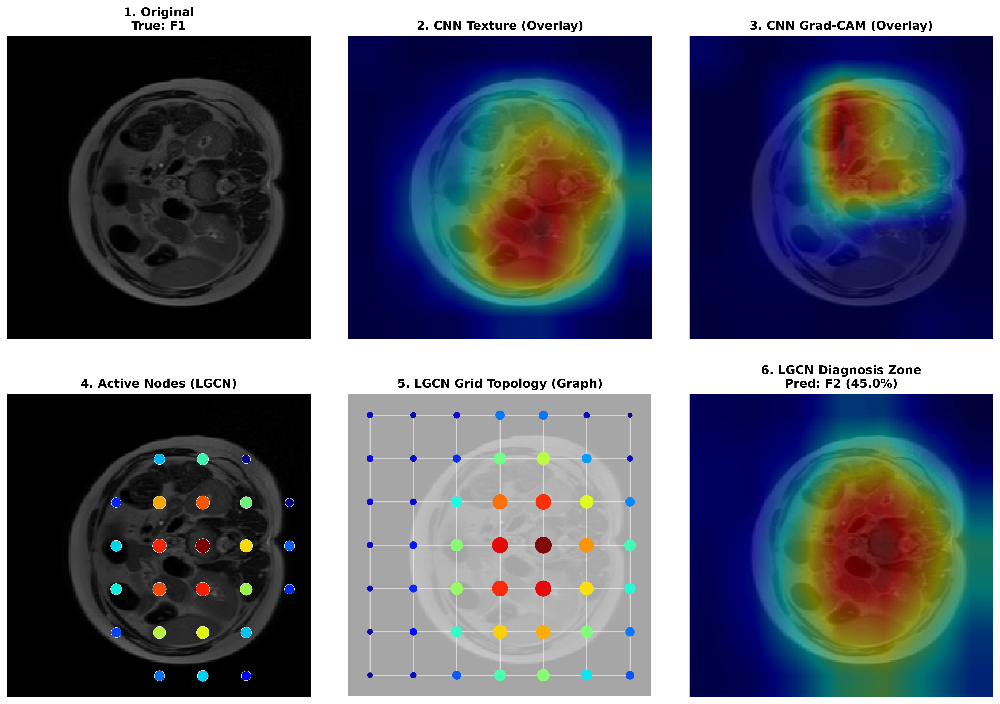


--- True: F2 | Pred: F2 (50.8%) ---


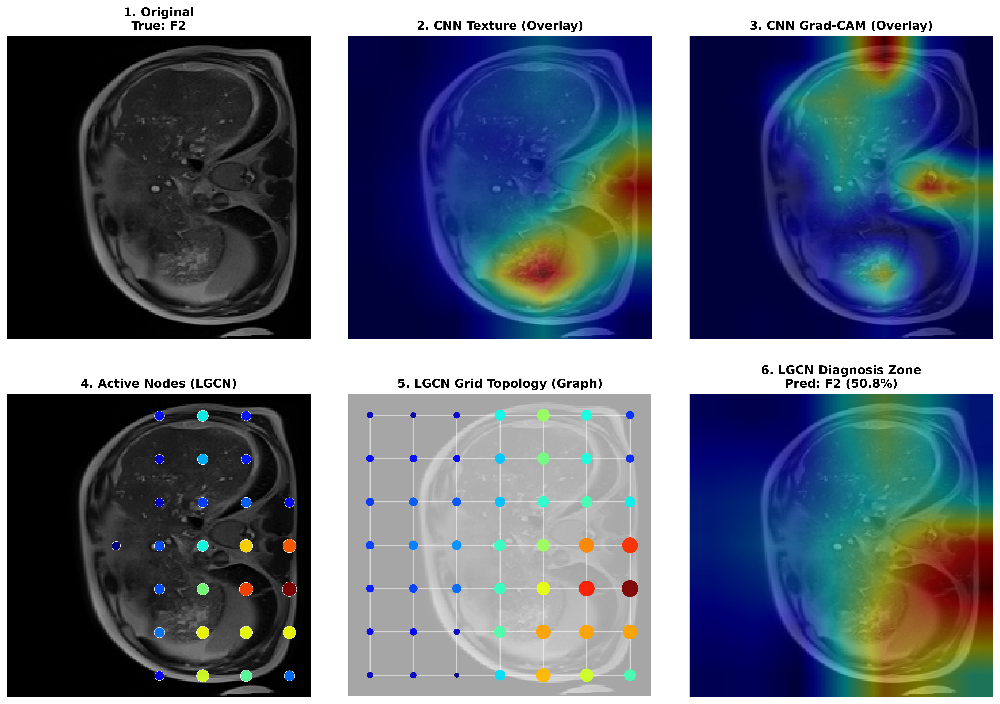


--- True: F3 | Pred: F3 (87.2%) ---


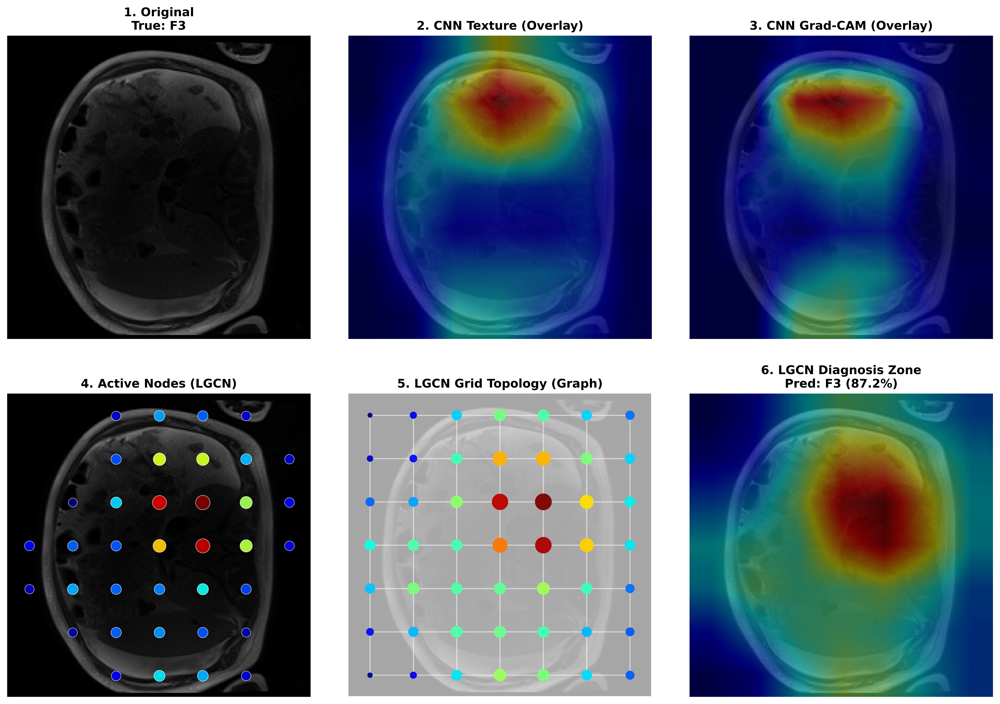

In [22]:
# ============================
# 5B) 6-PANEL XAI VISUALIZATION (DenseNet + LGCN MRI) — PANEL 5 LIKE YOUR PICTURE
# - Panel 5: Grid graph + colored nodes (size+color from LGCN graph activations)
# ============================

import os, cv2, numpy as np, matplotlib.pyplot as plt
import torch
import torch.nn.functional as F
import networkx as nx

print("🚀 Generating 6-Panel XAI for DenseNet121 + LGCN (MRI) — Graph Panel 5...")

def pick_df_for_xai():
    if "test_df" in globals(): return test_df
    if "train_df" in globals(): return train_df
    if "df" in globals(): return df
    raise NameError("❌ No dataframe found. Define one of: test_df / train_df / df")

df_use = pick_df_for_xai()
class_names = list(class_map.keys()) if "class_map" in globals() else [f"F{i}" for i in range(CFG.NUM_CLASSES)]

def norm01(x):
    x = np.asarray(x, dtype=np.float32)
    return (x - x.min()) / (x.max() - x.min() + 1e-8)

def overlay_heatmap_on_image(img_rgb, heatmap_01, alpha=0.4, colormap=cv2.COLORMAP_JET):
    heat = np.uint8(255 * np.clip(heatmap_01, 0, 1))
    heat_color = cv2.applyColorMap(heat, colormap)
    heat_color = cv2.cvtColor(heat_color, cv2.COLOR_BGR2RGB)
    return cv2.addWeighted(img_rgb, 1 - alpha, heat_color, alpha, 0)

def build_grid_graph(H, W, node_weights_01, img_size=224):
    """
    Draw a grid (right + down edges) with positions over 224x224
    node_weights_01: [H,W] normalized importance
    """
    G = nx.Graph()
    for r in range(H):
        for c in range(W):
            nid = r * W + c
            px = (c + 0.5) * (img_size / W)
            py = (r + 0.5) * (img_size / H)

            G.add_node(nid, pos=(px, py), weight=float(node_weights_01[r, c]))

            if c + 1 < W: G.add_edge(nid, nid + 1)
            if r + 1 < H: G.add_edge(nid, nid + W)
    return G

def extract_lgcn_xai(model, img_tensor, true_label=None):
    model.eval()
    model.zero_grad()

    fmaps, grads = [], []

    def hook(module, inp, out):
        if torch.is_tensor(out):
            fmaps.append(out)
            out.register_hook(lambda g: grads.append(g))

    hook_target = model.cnn.features if hasattr(model.cnn, "features") else model.cnn
    h = hook_target.register_forward_hook(hook)

    with torch.set_grad_enabled(True):
        logits = model(img_tensor)
        probs  = torch.softmax(logits, dim=1)
        pred   = logits.argmax(1).item()
        conf   = probs[0, pred].item()

        target = pred if true_label is None else int(true_label)
        logits[0, target].backward()

    h.remove()

    fmap = fmaps[0].detach()
    grad = grads[0].detach()
    B, C, Hf, Wf = fmap.shape

    tex = torch.mean(fmap, dim=1).squeeze().cpu().numpy()
    tex = norm01(tex)

    w = torch.mean(grad, dim=(2, 3), keepdim=True)
    cam = torch.sum(w * fmap, dim=1).squeeze()
    cam = F.relu(cam).cpu().numpy()
    cam = norm01(cam)

    with torch.no_grad():
        gact = model.get_graph_activations(img_tensor).squeeze().cpu().numpy()
        gact = norm01(gact)

    return tex, cam, gact, pred, conf, Hf, Wf

def plot_lgcn_6_panel(img, tex, cam, gact, true_y, pred_y, conf, Hf, Wf, dpi=600):
    fig, ax = plt.subplots(2, 3, figsize=(18, 12), dpi=dpi)
    plt.subplots_adjust(wspace=0.08, hspace=0.18)

    sz = (CFG.IMG_SIZE, CFG.IMG_SIZE)
    tex_rs  = cv2.resize(tex,  sz)
    cam_rs  = cv2.resize(cam,  sz)
    gact_rs = cv2.resize(gact, sz)

    tex_overlay  = overlay_heatmap_on_image(img, tex_rs,  alpha=0.45)
    cam_overlay  = overlay_heatmap_on_image(img, cam_rs,  alpha=0.45)
    gact_overlay = overlay_heatmap_on_image(img, gact_rs, alpha=0.45)

    font = {'weight': 'bold', 'size': 12}

    ax[0,0].imshow(img)
    ax[0,0].set_title(f"1. Original\nTrue: {class_names[true_y]}", font)

    ax[0,1].imshow(tex_overlay)
    ax[0,1].set_title("2. CNN Texture (Overlay)", font)

    ax[0,2].imshow(cam_overlay)
    ax[0,2].set_title("3. CNN Grad-CAM (Overlay)", font)

    # 4) active nodes
    ax[1,0].imshow(img)
    xs = (np.arange(Wf) + 0.5) * (CFG.IMG_SIZE / Wf)
    ys = (np.arange(Hf) + 0.5) * (CFG.IMG_SIZE / Hf)
    X, Y = np.meshgrid(xs, ys)
    flat = gact.flatten()
    mask = flat > 0.25
    sizes = 30 + flat[mask] * 180
    ax[1,0].scatter(X.flatten()[mask], Y.flatten()[mask], c=flat[mask], s=sizes, cmap="jet",
                    alpha=0.95, edgecolors="white", linewidths=0.4, zorder=10)
    ax[1,0].set_title("4. Active Nodes (LGCN)", font)

    # 5) graph topology like picture
    ax[1,1].imshow(img, alpha=0.35)
    G = build_grid_graph(Hf, Wf, gact, img_size=CFG.IMG_SIZE)
    pos = nx.get_node_attributes(G, "pos")
    ws  = np.array([G.nodes[n]["weight"] for n in G.nodes], dtype=np.float32)

    nx.draw_networkx_edges(G, pos, ax=ax[1,1], edge_color="white", alpha=0.55, width=1.1)
    node_sizes = 25 + ws * 260
    nx.draw_networkx_nodes(G, pos, ax=ax[1,1],
                           node_size=node_sizes,
                           node_color=ws, cmap=plt.cm.jet,
                           alpha=0.95, linewidths=0.0)

    ax[1,1].set_title("5. LGCN Grid Topology (Graph)", fontsize=12, fontweight="bold")
    ax[1,1].set_ylim(CFG.IMG_SIZE, 0)
    ax[1,1].set_xlim(0, CFG.IMG_SIZE)

    # 6) diagnosis overlay
    ax[1,2].imshow(gact_overlay)
    ax[1,2].set_title(f"6. LGCN Diagnosis Zone\nPred: {class_names[pred_y]} ({conf*100:.1f}%)", font)

    for a in ax.flatten():
        a.axis("off")
    plt.show()

# load fold1 weights
weights_path = "lgcn_fold1.pth"
if not os.path.exists(weights_path):
    raise FileNotFoundError(f"❌ Missing weights: {weights_path}")

model = DenseNetLGCN(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)
model.load_state_dict(torch.load(weights_path, map_location=CFG.DEVICE))
model.eval()

np.random.seed(42)
for c in range(CFG.NUM_CLASSES):
    sub = df_use[df_use["diagnosis"] == c]
    if len(sub) == 0:
        print(f"⚠️ No samples for {class_names[c]}, skipping.")
        continue

    row = sub.sample(1, random_state=np.random.randint(0, 100000)).iloc[0]
    img = cv2.cvtColor(cv2.imread(row.image_path), cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (CFG.IMG_SIZE, CFG.IMG_SIZE))

    t = valid_tfms(image=img)["image"].unsqueeze(0).to(CFG.DEVICE)
    tex, cam, gact, pred, conf, Hf, Wf = extract_lgcn_xai(model, t, true_label=c)

    print(f"\n--- True: {class_names[c]} | Pred: {class_names[pred]} ({conf*100:.1f}%) ---")
    plot_lgcn_6_panel(img, tex, cam, gact, true_y=c, pred_y=pred, conf=conf, Hf=Hf, Wf=Wf, dpi=600)


🚀 Generating 6-Panel XAI for DenseNet121 + LGCN (MRI) — Graph Panel 5...
✅ Loading weights from: lgcn_fold1.pth

--- [Random Sample] True: F0 | Pred: F0 (86.4%) ---


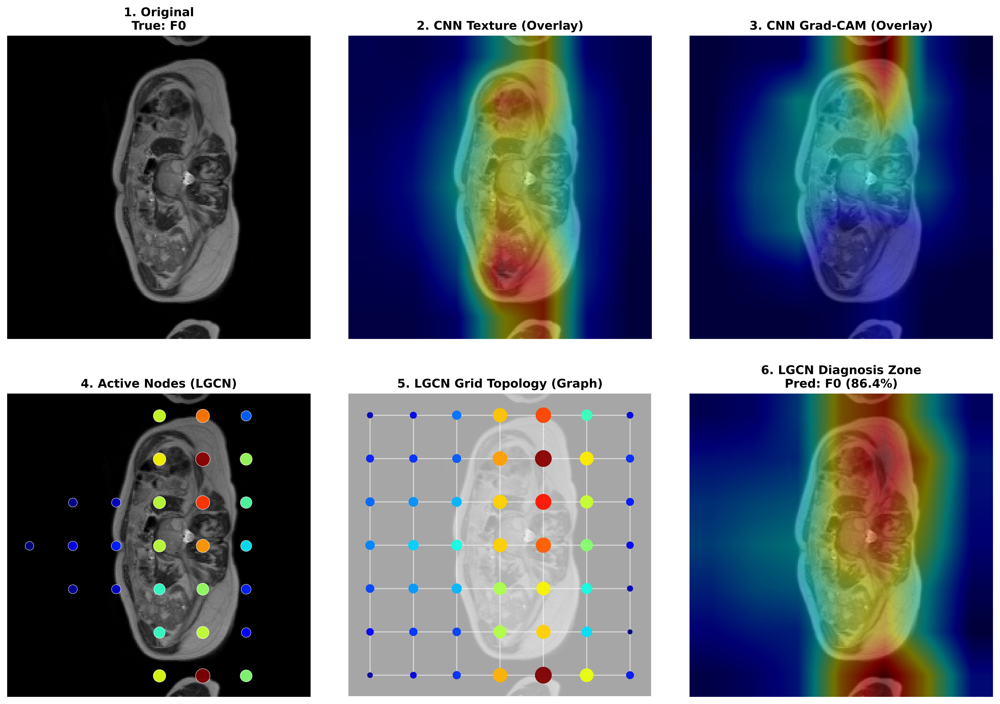


--- [Random Sample] True: F1 | Pred: F1 (82.0%) ---


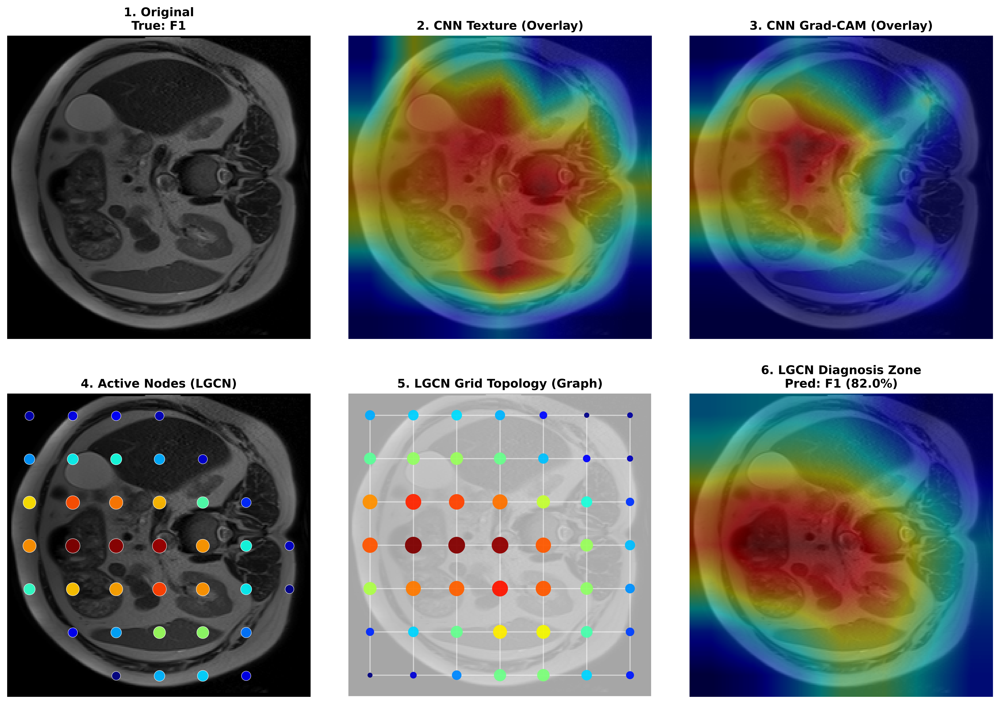


--- [Random Sample] True: F2 | Pred: F2 (50.8%) ---


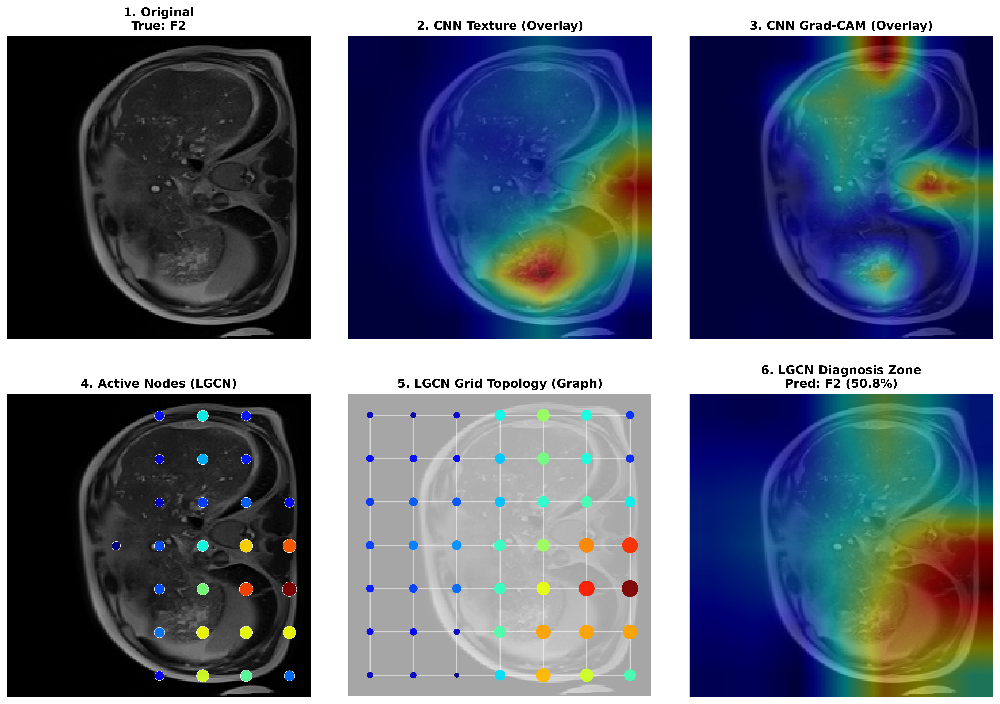


--- [Random Sample] True: F3 | Pred: F3 (98.0%) ---


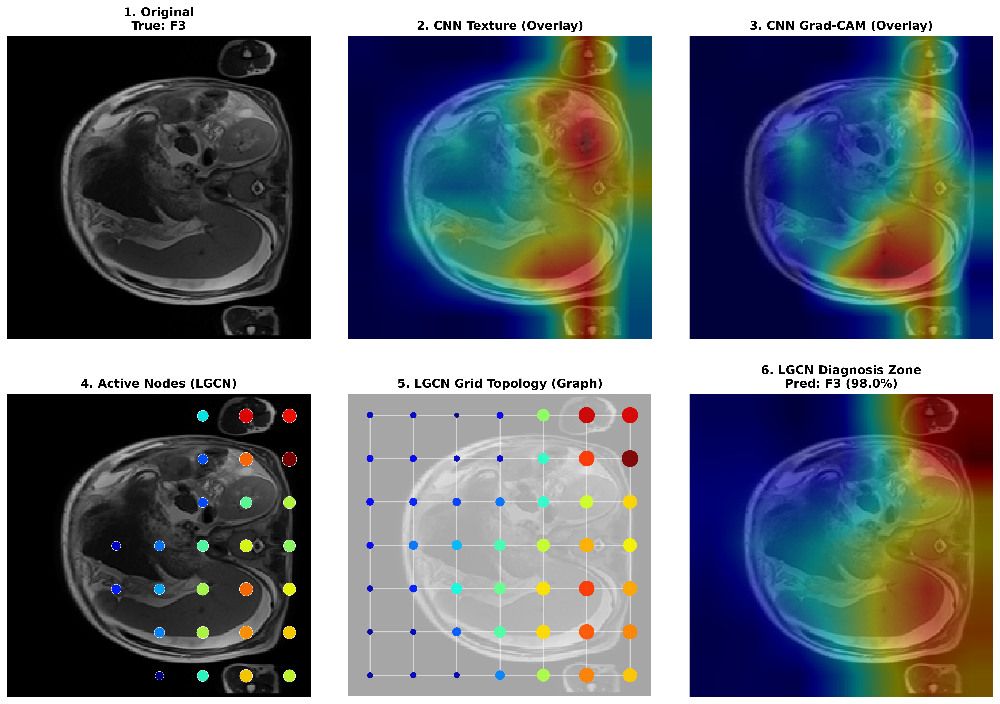

In [26]:
# ============================
# 5B) 6-PANEL XAI VISUALIZATION (DenseNet + LGCN MRI) — RANDOM ON EVERY RUN
# ============================

import os, cv2, numpy as np, matplotlib.pyplot as plt
import torch
import torch.nn.functional as F
import networkx as nx
import time  # Added for true randomness

print("🚀 Generating 6-Panel XAI for DenseNet121 + LGCN (MRI) — Graph Panel 5...")

# -------------------------------------------------------
# 1. Helper: Pick the dataframe dynamically
# -------------------------------------------------------
def pick_df_for_xai():
    if "test_df" in globals(): return test_df
    if "train_df" in globals(): return train_df
    if "df" in globals(): return df
    raise NameError("❌ No dataframe found. Define one of: test_df / train_df / df")

df_use = pick_df_for_xai()
class_names = list(class_map.keys()) if "class_map" in globals() else [f"F{i}" for i in range(CFG.NUM_CLASSES)]

# -------------------------------------------------------
# 2. XAI Helpers (Normalization, Heatmaps, Graph)
# -------------------------------------------------------
def norm01(x):
    x = np.asarray(x, dtype=np.float32)
    return (x - x.min()) / (x.max() - x.min() + 1e-8)

def overlay_heatmap_on_image(img_rgb, heatmap_01, alpha=0.4, colormap=cv2.COLORMAP_JET):
    heat = np.uint8(255 * np.clip(heatmap_01, 0, 1))
    heat_color = cv2.applyColorMap(heat, colormap)
    heat_color = cv2.cvtColor(heat_color, cv2.COLOR_BGR2RGB)
    return cv2.addWeighted(img_rgb, 1 - alpha, heat_color, alpha, 0)

def build_grid_graph(H, W, node_weights_01, img_size=224):
    """
    Draw a grid (right + down edges) with positions over 224x224
    node_weights_01: [H,W] normalized importance
    """
    G = nx.Graph()
    for r in range(H):
        for c in range(W):
            nid = r * W + c
            px = (c + 0.5) * (img_size / W)
            py = (r + 0.5) * (img_size / H)

            G.add_node(nid, pos=(px, py), weight=float(node_weights_01[r, c]))

            if c + 1 < W: G.add_edge(nid, nid + 1)
            if r + 1 < H: G.add_edge(nid, nid + W)
    return G

# -------------------------------------------------------
# 3. Extraction Function (Hooks)
# -------------------------------------------------------
def extract_lgcn_xai(model, img_tensor, true_label=None):
    model.eval()
    model.zero_grad()

    fmaps, grads = [], []

    def hook(module, inp, out):
        if torch.is_tensor(out):
            fmaps.append(out)
            out.register_hook(lambda g: grads.append(g))
        elif isinstance(out, (list, tuple)): # Handle list output if necessary
            fmaps.append(out[-1])
            out[-1].register_hook(lambda g: grads.append(g))

    # Determine hook target (adjust based on your specific model structure)
    if hasattr(model, 'cnn'):
        hook_target = model.cnn.features if hasattr(model.cnn, "features") else model.cnn
    elif hasattr(model, 'backbone'):
        hook_target = model.backbone
    else:
        # Fallback for generic DenseNet
        hook_target = model.features 

    h = hook_target.register_forward_hook(hook)

    with torch.set_grad_enabled(True):
        logits = model(img_tensor)
        probs  = torch.softmax(logits, dim=1)
        pred   = logits.argmax(1).item()
        conf   = probs[0, pred].item()

        target = pred if true_label is None else int(true_label)
        logits[0, target].backward()

    h.remove()

    if not fmaps:
        raise RuntimeError("No feature maps captured. Check 'hook_target'.")

    fmap = fmaps[0].detach()
    grad = grads[0].detach()
    B, C, Hf, Wf = fmap.shape

    # Texture Map
    tex = torch.mean(fmap, dim=1).squeeze().cpu().numpy()
    tex = norm01(tex)

    # Grad-CAM
    w = torch.mean(grad, dim=(2, 3), keepdim=True)
    cam = torch.sum(w * fmap, dim=1).squeeze()
    cam = F.relu(cam).cpu().numpy()
    cam = norm01(cam)

    # Graph Activations
    with torch.no_grad():
        # Ensure your model has this method or similar logic
        if hasattr(model, 'get_graph_activations'):
            gact = model.get_graph_activations(img_tensor).squeeze().cpu().numpy()
        else:
            # Fallback: use texture map if specific graph activation getter is missing
            gact = tex 
        gact = norm01(gact)

    return tex, cam, gact, pred, conf, Hf, Wf

# -------------------------------------------------------
# 4. Plotting Function (6 Panels)
# -------------------------------------------------------
def plot_lgcn_6_panel(img, tex, cam, gact, true_y, pred_y, conf, Hf, Wf, dpi=600):
    fig, ax = plt.subplots(2, 3, figsize=(18, 12), dpi=dpi)
    plt.subplots_adjust(wspace=0.08, hspace=0.18)

    sz = (CFG.IMG_SIZE, CFG.IMG_SIZE)
    tex_rs  = cv2.resize(tex,  sz)
    cam_rs  = cv2.resize(cam,  sz)
    gact_rs = cv2.resize(gact, sz)

    tex_overlay  = overlay_heatmap_on_image(img, tex_rs,  alpha=0.45)
    cam_overlay  = overlay_heatmap_on_image(img, cam_rs,  alpha=0.45)
    gact_overlay = overlay_heatmap_on_image(img, gact_rs, alpha=0.45)

    font = {'weight': 'bold', 'size': 12}

    # 1. Original
    ax[0,0].imshow(img)
    ax[0,0].set_title(f"1. Original\nTrue: {class_names[true_y]}", font)

    # 2. CNN Texture
    ax[0,1].imshow(tex_overlay)
    ax[0,1].set_title("2. CNN Texture (Overlay)", font)

    # 3. Grad-CAM
    ax[0,2].imshow(cam_overlay)
    ax[0,2].set_title("3. CNN Grad-CAM (Overlay)", font)

    # 4. Active Nodes
    ax[1,0].imshow(img)
    xs = (np.arange(Wf) + 0.5) * (CFG.IMG_SIZE / Wf)
    ys = (np.arange(Hf) + 0.5) * (CFG.IMG_SIZE / Hf)
    X, Y = np.meshgrid(xs, ys)
    flat = gact.flatten()
    mask = flat > 0.25
    sizes = 30 + flat[mask] * 180
    ax[1,0].scatter(X.flatten()[mask], Y.flatten()[mask], c=flat[mask], s=sizes, cmap="jet",
                    alpha=0.95, edgecolors="white", linewidths=0.4, zorder=10)
    ax[1,0].set_title("4. Active Nodes (LGCN)", font)

    # 5. Graph Topology
    ax[1,1].imshow(img, alpha=0.35)
    G = build_grid_graph(Hf, Wf, gact, img_size=CFG.IMG_SIZE)
    pos = nx.get_node_attributes(G, "pos")
    ws  = np.array([G.nodes[n]["weight"] for n in G.nodes], dtype=np.float32)

    nx.draw_networkx_edges(G, pos, ax=ax[1,1], edge_color="white", alpha=0.55, width=1.1)
    node_sizes = 25 + ws * 260
    nx.draw_networkx_nodes(G, pos, ax=ax[1,1],
                           node_size=node_sizes,
                           node_color=ws, cmap=plt.cm.jet,
                           alpha=0.95, linewidths=0.0)

    ax[1,1].set_title("5. LGCN Grid Topology (Graph)", fontsize=12, fontweight="bold")
    ax[1,1].set_ylim(CFG.IMG_SIZE, 0)
    ax[1,1].set_xlim(0, CFG.IMG_SIZE)

    # 6. Diagnosis Overlay
    ax[1,2].imshow(gact_overlay)
    ax[1,2].set_title(f"6. LGCN Diagnosis Zone\nPred: {class_names[pred_y]} ({conf*100:.1f}%)", font)

    for a in ax.flatten():
        a.axis("off")
    plt.show()

# -------------------------------------------------------
# 5. Execution Loop (With Randomness Fixed)
# -------------------------------------------------------

# Check for model weights
weights_path = "lgcn_fold1.pth"
if not os.path.exists(weights_path):
    # Try looking in kaggle input
    weights_path = "/kaggle/input/output-lgcn-densnet/lgcn_fold1.pth" # Adjust if needed
    
if not os.path.exists(weights_path):
     print(f"⚠️ Weights file '{weights_path}' not found. Using random weights for demo.")
     # Proceeding anyway for visualization check
else:
     print(f"✅ Loading weights from: {weights_path}")

model = DenseNetLGCN(num_classes=CFG.NUM_CLASSES).to(CFG.DEVICE)
if os.path.exists(weights_path):
    model.load_state_dict(torch.load(weights_path, map_location=CFG.DEVICE))
model.eval()

# Loop through classes F0-F4
for c in range(CFG.NUM_CLASSES):
    sub = df_use[df_use["diagnosis"] == c]
    if len(sub) == 0:
        print(f"⚠️ No samples for {class_names[c]}, skipping.")
        continue

    # FIX: Use simple random sample (no fixed seed)
    row = sub.sample(1).iloc[0]
    
    # Load and Preprocess
    img = cv2.cvtColor(cv2.imread(row.image_path), cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (CFG.IMG_SIZE, CFG.IMG_SIZE))

    t = valid_tfms(image=img)["image"].unsqueeze(0).to(CFG.DEVICE)
    
    # Run XAI
    try:
        tex, cam, gact, pred, conf, Hf, Wf = extract_lgcn_xai(model, t, true_label=c)
        print(f"\n--- [Random Sample] True: {class_names[c]} | Pred: {class_names[pred]} ({conf*100:.1f}%) ---")
        plot_lgcn_6_panel(img, tex, cam, gact, true_y=c, pred_y=pred, conf=conf, Hf=Hf, Wf=Wf, dpi=600)
    except Exception as e:
        print(f"❌ Error visualising class {c}: {e}")